# Import dependencies

In [1]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from tqdm import tqdm

from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering

from sklearn import metrics
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score

In [2]:
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense

# Load Data

In [3]:
data_embed = pd.read_csv("./term_embeddings/vectorized_term_embeddings_4k.csv")
data_embed.head()

,0,1,2,3,4,5,6,7,8,9,...,758,759,760,761,762,763,764,765,766,767
0,-0.235717,-0.034357,0.059340,0.297741,0.413503,-0.005965,0.053272,-0.109700,0.191787,0.184964,...,0.222023,-0.038877,-0.471914,0.768315,-0.488685,0.120664,0.782061,-0.179443,-0.428450,0.461683
1,-0.178516,0.002904,0.131155,0.332376,0.247463,0.099109,-0.000515,0.026755,0.152213,0.175770,...,0.283444,-0.155591,-0.345533,0.806833,-0.311759,0.207827,0.600389,-0.149813,-0.418629,0.541288
2,-0.330687,-0.031855,0.105278,0.078271,0.195134,-0.136877,0.117263,-0.054845,0.206244,0.265202,...,0.215846,-0.030670,-0.520877,0.729626,-0.386960,0.177576,0.676565,-0.328219,-0.565267,0.506224
3,-0.281114,-0.042354,0.105358,0.152034,0.230870,-0.142952,0.144465,-0.065642,0.168137,0.245674,...,0.188485,-0.022974,-0.496699,0.746730,-0.406173,0.157490,0.685346,-0.276632,-0.548756,0.495335
4,-0.304600,-0.016233,0.152511,0.173860,0.161872,-0.073577,0.122591,-0.008369,0.165817,0.273474,...,0.204433,-0.045393,-0.448815,0.680492,-0.389678,0.141336,0.665190,-0.325107,-0.504376,0.517802


In [4]:
all_data = pd.read_csv(
    "../tests_17_ann_and_terms/article_v2_2_term_var_to_best_strategy/prepare_data/data_steps/steps_vars_term_str.csv",
    delimiter=',')

# leave only unique terms
print(f"Count all terms: {len(all_data)}")

print(f"max RI steps count: {max(all_data['RI_steps_num'])}")
print(f"max LO steps count: {max(all_data['LO_steps_num'])}")

# RI == LO -> 0
# RI > LO -> 1
# RI < LO -> 2
class_RI_LO = ["RI = LO" if los == ris else "RI < LO" if ris < los else "LO < RI" for los, ris in
               zip(all_data["LO_steps_num"].tolist(), all_data["RI_steps_num"].tolist())]

print(f"Count terms data samples: {len(class_RI_LO)}")

Count all terms: 4282
max RI steps count: 1000
max LO steps count: 219
Count terms data samples: 4282


# Some additional functions

In [5]:
pca = PCA(n_components=2)  # Set the number of components as needed
principal_components = pca.fit_transform(data_embed)

tsne = TSNE(n_components=2, random_state=42)
embedded_data = tsne.fit_transform(data_embed)


def visualize_clusters(model_, clustering_method):
    pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
    pca_df['class'] = model_.labels_

    # Plot the PCA results with colorization based on the 'class' column
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x='PC1', y='PC2', hue='class', data=pca_df, palette="deep")
    plt.title(f'PCA results of {clustering_method}')
    plt.xlabel('Principal Component 1 (PC1)')
    plt.ylabel('Principal Component 2 (PC2)')
    plt.legend()
    plt.show()

    tsne_df = pd.DataFrame(data=embedded_data, columns=['Dim 1', 'Dim 2'])
    tsne_df['class'] = model_.labels_

    # Plot the PCA results with colorization based on the 'class' column
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x='Dim 1', y='Dim 2', hue='class', data=tsne_df, palette="deep")
    plt.title(f't-SNE results of {clustering_method}')
    plt.xlabel('Dim 1')
    plt.ylabel('Dim 2')
    plt.legend()
    plt.show()

In [6]:
pca_3d = PCA(n_components=3)  # Set the number of components as needed
principal_components_3d = pca_3d.fit_transform(data_embed)

tsne_3d = TSNE(n_components=3, random_state=42)
embedded_data_3d = tsne_3d.fit_transform(data_embed)


def visualize_clusters_3d_pca(model_, clustering_method):
    pca_df_3d = pd.DataFrame(data=principal_components_3d, columns=['PC1', 'PC2', 'PC3'])
    pca_df_3d['class'] = [f"{x_}" for x_ in list(model_.labels_)]

    fig = px.scatter_3d(
        pca_df_3d, x='PC1', y='PC2', z='PC3',
        color='class', title=f"PCA 3D, {clustering_method}",
    )

    fig.update_traces(marker=dict(size=2))
    fig.show()


def visualize_clusters_3d_tsne(model_, clustering_method):
    tsne_df_3d = pd.DataFrame(data=embedded_data_3d, columns=["Dim 1", "Dim 2", "Dim 3"])
    tsne_df_3d['class'] = [f"{x_}" for x_ in list(model_.labels_)]

    fig = px.scatter_3d(
        tsne_df_3d, x='Dim 1', y='Dim 2', z='Dim 3',
        color='class', title=f"t-SNE 3D, {clustering_method}",
    )

    fig.update_traces(marker=dict(size=2))
    fig.show()

In [7]:
def draw_metrics(num_clusters, metric_cluster_vals, xlabel="Num clusters", ylabel="Metric", title="Clustering Method"):
    plt.plot(num_clusters, metric_cluster_vals)

    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(f"{ylabel} for {title}")

    plt.show()

In [8]:
def draw_metrics_many_norm(num_clusters, metric_cluster_vals_dict: dict, xlabel="Num clusters", ylabel="cl_metric",
                           title="Clustering Method"):
    for name_, metric_cluster_vals in metric_cluster_vals_dict.items():
        metric_cluster_vals = np.array(metric_cluster_vals) / np.max(metric_cluster_vals)
        plt.plot(num_clusters, metric_cluster_vals, label=name_)

    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)

    plt.legend(loc="upper right")
    plt.show()

In [9]:
def wcss_metric(x_data, labels_):
    pd_x_data = x_data.copy(deep=True)
    pd_x_data["class"] = list(labels_)

    wcss = 0.0
    for cl_no in set(list(labels_)):
        cl_x_data = pd_x_data[pd_x_data["class"] == cl_no].drop(["class"], axis=1).reset_index(drop=True)
        cl_center = cl_x_data.mean(axis=0)
        css = 0.0
        for _, cl_x in cl_x_data.iterrows():
            cl_x = np.array(cl_x)
            css += np.sum(np.power(cl_x - cl_center, 2))
        wcss += css

    return wcss

In [31]:
def show_clustering_metrics(x_data, model_):
    print(f"Silhouette Score (MORE): {silhouette_score(x_data, model_.labels_)}")
    print(f"Davies-Bouldin Index (LESS): {davies_bouldin_score(x_data, model_.labels_)}")
    print(f"Calinski-Harabasz Index (MORE): {calinski_harabasz_score(x_data, model_.labels_)}")
    print(f"WCSS (LESS): {wcss_metric(x_data, model_.labels_)}")


# k-means clustering

In [11]:
# Use elbow method to define optimal clusters count
K_nums = range(2, 30)
fits = []
silhouette_scores = []
davies_bouldin_indexes = []
calinski_harabasz_indexes = []
wcss_metrics = []

for k in tqdm(K_nums):
    model = KMeans(n_clusters=k, random_state=0, n_init=100).fit(data_embed)
    fits.append(model)

    silhouette_scores.append(silhouette_score(data_embed, model.labels_, metric='euclidean'))
    davies_bouldin_indexes.append(davies_bouldin_score(data_embed, model.labels_))
    calinski_harabasz_indexes.append(calinski_harabasz_score(data_embed, model.labels_))
    wcss_metrics.append(wcss_metric(data_embed, model.labels_))

100%|██████████| 28/28 [08:13<00:00, 17.62s/it]


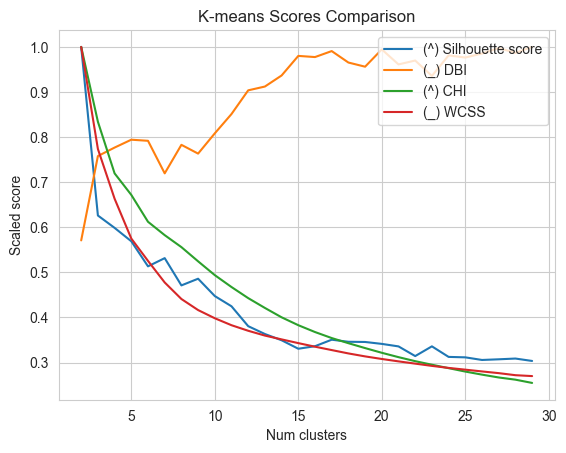

In [16]:
draw_metrics_many_norm(
    K_nums,
    {
        "(^) Silhouette score": silhouette_scores,
        "(_) DBI": davies_bouldin_indexes,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num clusters",
    ylabel="Scaled score",
    title="K-means Scores Comparison",
)

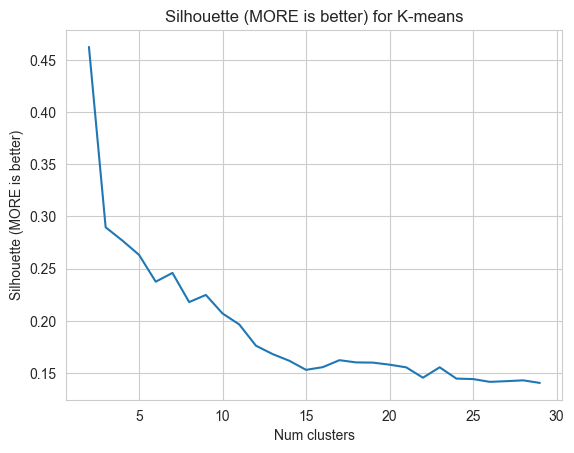

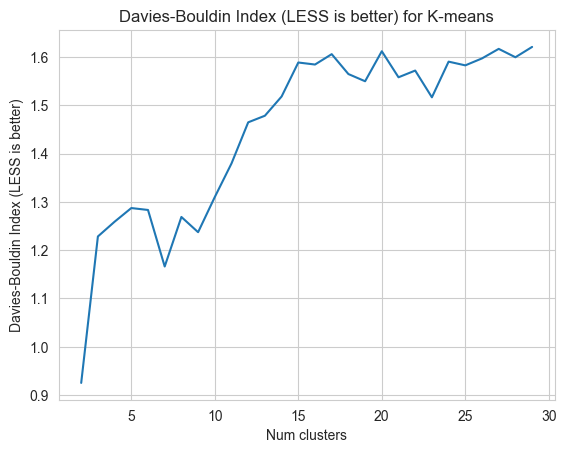

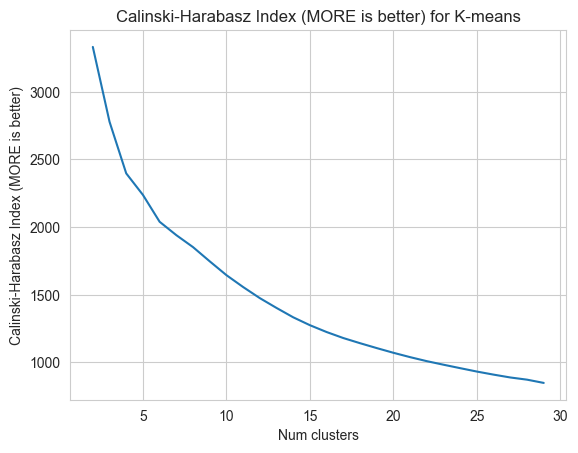

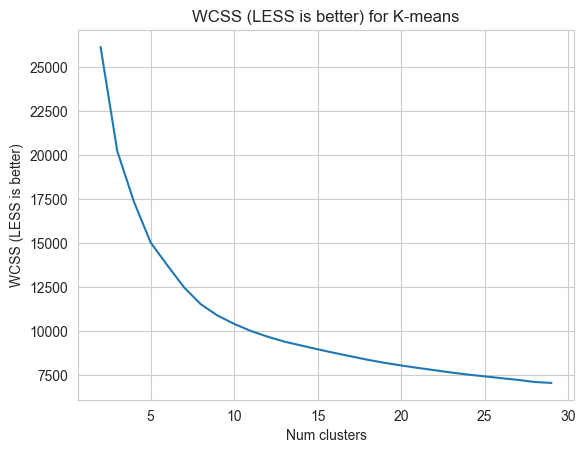

In [14]:
draw_metrics(K_nums, silhouette_scores, ylabel="Silhouette (MORE is better)", title="K-means")
draw_metrics(K_nums, davies_bouldin_indexes, ylabel="Davies-Bouldin Index (LESS is better)", title="K-means")
draw_metrics(K_nums, calinski_harabasz_indexes, ylabel="Calinski-Harabasz Index (MORE is better)", title="K-means")
draw_metrics(K_nums, wcss_metrics, ylabel="WCSS (LESS is better)", title="K-means")

In [11]:
def optimalK(data, maxClusters):
    """
    Calculates KMeans optimal K using Gap Statistic from Tibshirani, Walther, Hastie
    Params:
        data: ndarry of shape (n_samples, n_features)
        nrefs: number of sample reference datasets to create
        maxClusters: Maximum number of clusters to test for
    Returns: (gaps, optimalK)
    """
    nrefs = 3
    gaps = np.zeros((len(range(1, maxClusters)),))
    resultsdf = pd.DataFrame({'clusterCount': [], 'gap': []})
    for gap_index, k in enumerate(tqdm(range(1, maxClusters))):

        # Holder for reference dispersion results
        refDisps = np.zeros(nrefs)

        # For n references, generate random sample and perform kmeans getting resulting dispersion of each loop
        for i in range(nrefs):
            # Create new random reference set
            randomReference = np.random.random_sample(size=data.shape)

            # Fit to it
            km = KMeans(k)
            km.fit(randomReference)

            refDisp = km.inertia_
            refDisps[i] = refDisp

        # Fit cluster to original data and create dispersion
        km = KMeans(k)
        km.fit(data)

        origDisp = km.inertia_

        # Calculate gap statistic
        gap = np.log(np.mean(refDisps)) - np.log(origDisp)

        # Assign this loop's gap statistic to gaps
        gaps[gap_index] = gap

        resultsdf = resultsdf.append({'clusterCount': k, 'gap': gap}, ignore_index=True)

    return (gaps.argmax() + 1,
            resultsdf)  # Plus 1 because index of 0 means 1 cluster is optimal, index 2 = 3 clusters are optimal

In [12]:
opt_num_clusters, gapdf = optimalK(data_embed, maxClusters=30)
print('Optimal k is: ', opt_num_clusters)

  0%|          | 0/29 [00:00<?, ?it/s]C:\Users\voldo\AppData\Local\Temp\ipykernel_29100\1551017064.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  resultsdf = resultsdf.append({'clusterCount':k, 'gap':gap}, ignore_index=True)
  3%|▎         | 1/29 [00:00<00:24,  1.14it/s]C:\Users\voldo\AppData\Local\Temp\ipykernel_29100\1551017064.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  resultsdf = resultsdf.append({'clusterCount':k, 'gap':gap}, ignore_index=True)
  7%|▋         | 2/29 [00:04<01:06,  2.46s/it]C:\Users\voldo\AppData\Local\Temp\ipykernel_29100\1551017064.py:43: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  resultsdf = resultsdf.append({'clusterCount':k, 'gap':gap}, ignore_index=True)
 10%|█         | 3/29 [0

Optimal k is:  29


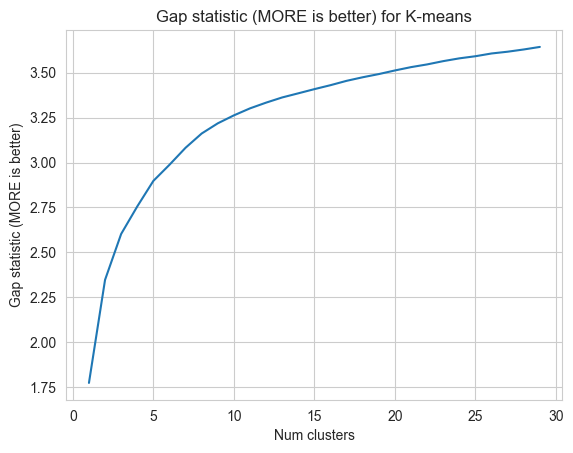

In [13]:
draw_metrics(gapdf.clusterCount, gapdf.gap, ylabel="Gap statistic (MORE is better)", title="K-means")

# K-means 2

By image the optimal number of clusters is 15 (using elbow method).
But we try 2, 3 and 15 clusters and plot them

In [108]:
model = KMeans(n_clusters=2, random_state=0, n_init=100).fit(data_embed)
show_clustering_metrics(data_embed, model)

Silhouette Score (MORE): 0.4625104329551552
Davies-Bouldin Index (LESS): 0.9252658045698924
Calinski-Harabasz Index (MORE): 3331.1991909544413
WCSS (LESS): 26147.284315963243


In [109]:
ann_model = Sequential([
    Dense(48, activation='relu', input_shape=(768,)),
    Dense(48, activation='relu'),
    Dense(48, activation='relu'),
    Dense(2, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(model.labels_), epochs=100)

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_36 (Dense)            (None, 48)                36912     
                                                                 
 dense_37 (Dense)            (None, 48)                2352      
                                                                 
 dense_38 (Dense)            (None, 48)                2352      
                                                                 
 dense_39 (Dense)            (None, 2)                 98        
                                                                 
Total params: 41,714
Trainable params: 41,714
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==============================] - 1s 5ms/step - loss: 0.1217 - accuracy: 0.9493
Epoch 2/100
134/134 [==============================] - 1s 4ms/step - loss: 0.0391

In [110]:
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())

[2.27046525e-03 8.49602092e-03 7.19031133e-03 1.68878045e-02
 1.11704133e-02 6.65923255e-03 8.57760198e-03 2.28508878e-02
 5.19648427e-03 2.99258274e-03 5.72974142e-03 1.97578762e-02
 9.04292334e-03 2.79423804e-03 6.77883800e-05 1.29547892e-02
 1.49398984e-04 2.27685482e-03 4.20592353e-03 1.39328698e-02
 1.55711025e-02 7.14859692e-03 8.02491966e-04 6.10643486e-03
 5.87729597e-03 2.41893553e-03 6.99588750e-03 6.67846762e-03
 5.10702142e-03 6.16686512e-03 8.88064597e-03 2.22668033e-02
 4.03303141e-03 5.61495917e-03 3.69245582e-03 1.56384334e-02
 2.89092027e-03 2.12096114e-04 9.75601797e-05 3.76838050e-03
 8.03567283e-03 8.05350428e-04 2.00288789e-03 1.65189467e-02
 2.55300943e-03 9.45079664e-04 2.25915969e-03 2.62525473e-02
 2.30380800e-03 4.84088110e-03 3.37100308e-03 1.61060994e-03
 1.12081692e-03 1.03889412e-04 2.93023000e-03 1.17098019e-02
 2.74167047e-03 4.58590453e-03 8.91002303e-04 7.03221420e-04
 4.16447269e-03 1.51021117e-02 1.62106622e-02 3.81555245e-03
 1.72385504e-03 4.537768

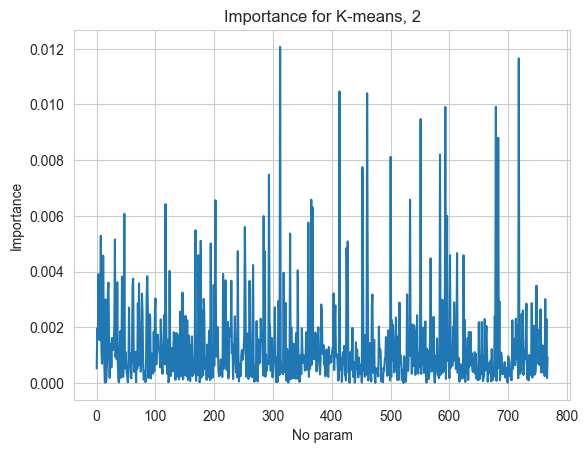

In [111]:
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 2"
)

In [112]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
312,var_312,0.012067,0.012067
718,var_718,0.011651,0.023718
413,var_413,0.010469,0.034187
460,var_460,0.010401,0.044588
679,var_679,0.009918,0.054506
593,var_593,0.009913,0.064419
551,var_551,0.009475,0.073895
683,var_683,0.008808,0.082703
584,var_584,0.008204,0.090907
500,var_500,0.008119,0.099026


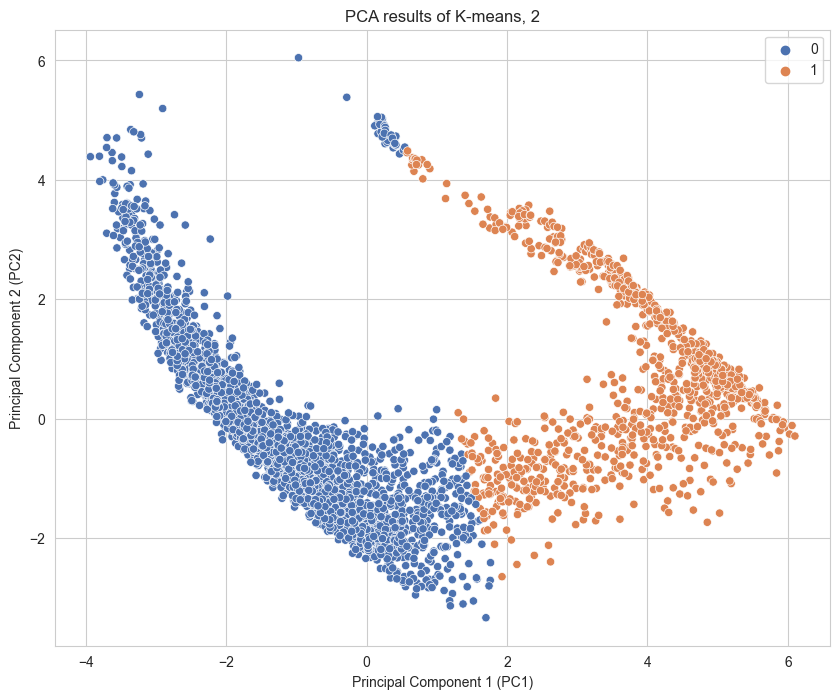

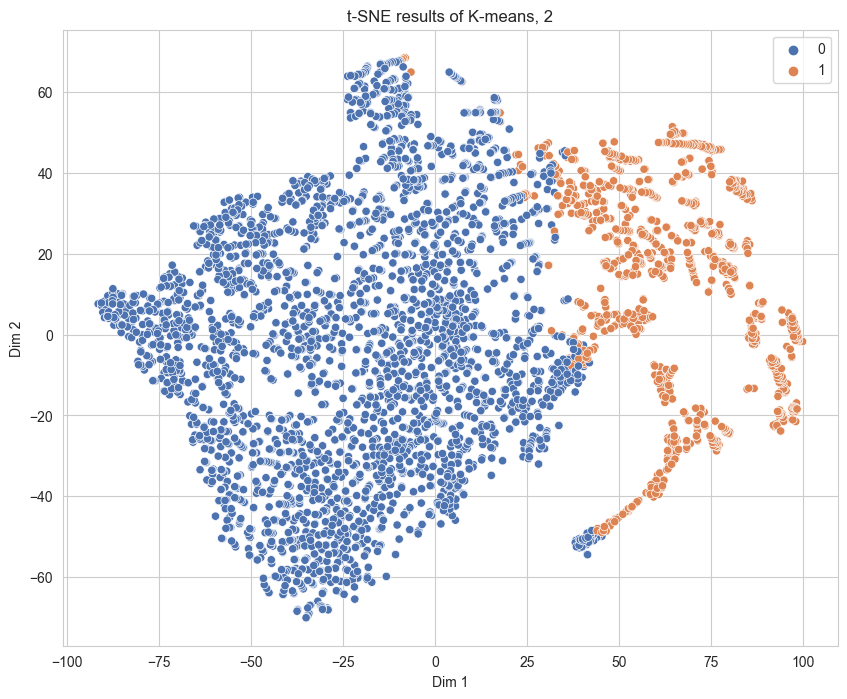

In [15]:
visualize_clusters(model, "K-means, 2")

In [16]:
visualize_clusters_3d_pca(model, "K-means, 2")

In [17]:
visualize_clusters_3d_tsne(model, "K-means, 2")

# K-means 3

In [104]:
model = KMeans(n_clusters=3, random_state=0, n_init=100).fit(data_embed)
show_clustering_metrics(data_embed, model)

Silhouette Score (MORE): 0.28956842707111624
Davies-Bouldin Index (LESS): 1.228402239093346
Calinski-Harabasz Index (MORE): 2778.45797287985
WCSS (LESS): 20228.48631011698


Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_32 (Dense)            (None, 48)                36912     
                                                                 
 dense_33 (Dense)            (None, 48)                2352      
                                                                 
 dense_34 (Dense)            (None, 48)                2352      
                                                                 
 dense_35 (Dense)            (None, 3)                 147       
                                                                 
Total params: 41,763
Trainable params: 41,763
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==============================] - 1s 4ms/step - loss: 0.3631 - accuracy: 0.8557
Epoch 2/100
134/134 [==============================] - 0s 4ms/step - loss: 0.1129

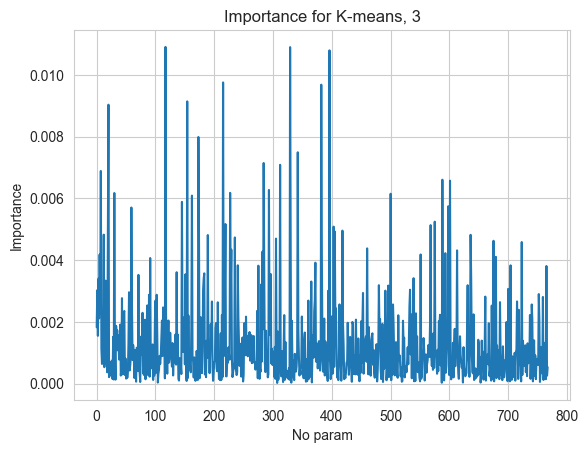

In [105]:
ann_model = Sequential([
    Dense(48, activation='relu', input_shape=(768,)),
    Dense(48, activation='relu'),
    Dense(48, activation='relu'),
    Dense(3, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(model.labels_), epochs=100)
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 3"
)

In [107]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
117,var_117,0.010907,0.010907
329,var_329,0.010899,0.021806
396,var_396,0.010796,0.032602
215,var_215,0.009757,0.042359
382,var_382,0.009683,0.052042
154,var_154,0.009143,0.061185
20,var_20,0.009035,0.070221
173,var_173,0.007990,0.078211
342,var_342,0.007494,0.085705
284,var_284,0.007147,0.092852


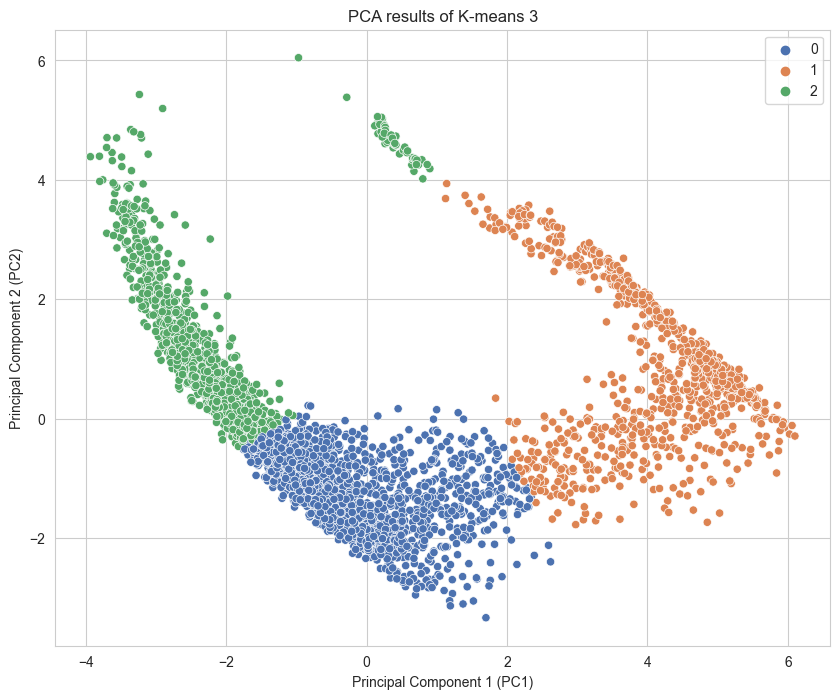

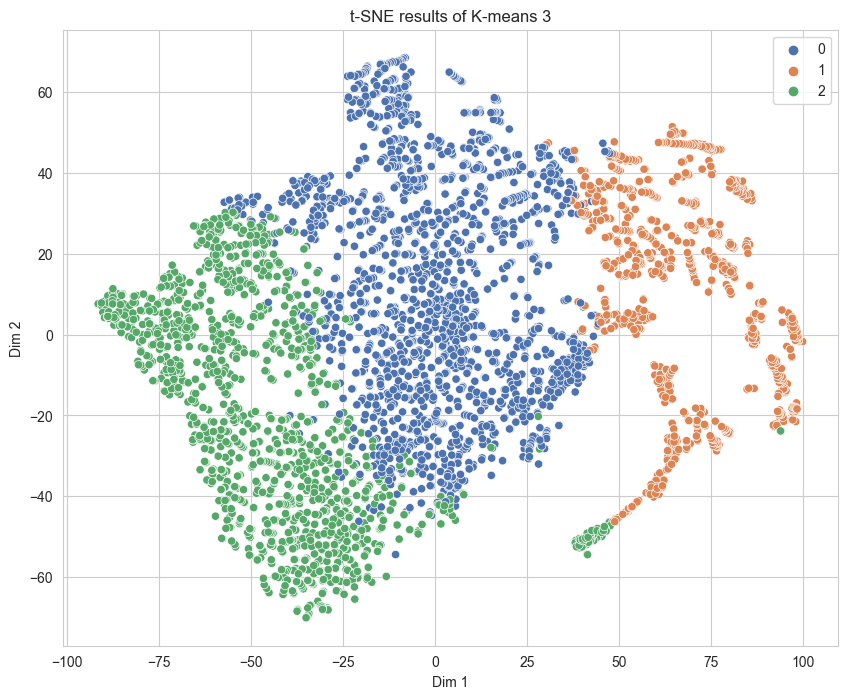

In [19]:
visualize_clusters(model, "K-means 3")

In [20]:
visualize_clusters_3d_pca(model, "K-means, 3")

In [21]:
visualize_clusters_3d_tsne(model, "K-means, 3")

# K-means 7

In [113]:
model = KMeans(n_clusters=7, random_state=0, n_init=100).fit(data_embed)
show_clustering_metrics(data_embed, model)

Silhouette Score (MORE): 0.24584543353909905
Davies-Bouldin Index (LESS): 1.1662349118570925
Calinski-Harabasz Index (MORE): 1940.5199010985211
WCSS (LESS): 12487.63709321951


Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_40 (Dense)            (None, 48)                36912     
                                                                 
 dense_41 (Dense)            (None, 48)                2352      
                                                                 
 dense_42 (Dense)            (None, 48)                2352      
                                                                 
 dense_43 (Dense)            (None, 7)                 343       
                                                                 
Total params: 41,959
Trainable params: 41,959
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==============================] - 1s 5ms/step - loss: 0.8552 - accuracy: 0.7041
Epoch 2/100
134/134 [==============================] - 1s 5ms/step - loss: 0.261

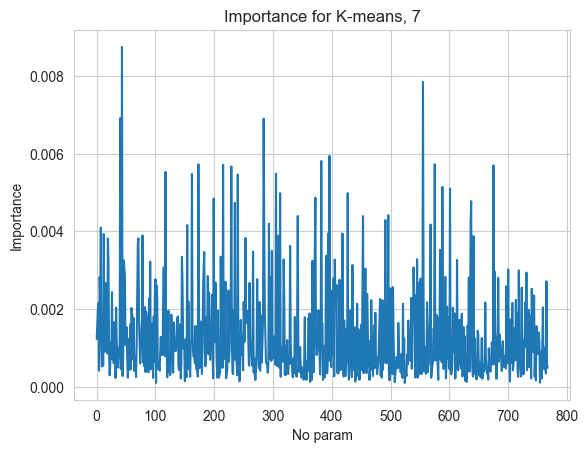

In [114]:
ann_model = Sequential([
    Dense(48, activation='relu', input_shape=(768,)),
    Dense(48, activation='relu'),
    Dense(48, activation='relu'),
    Dense(7, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(model.labels_), epochs=100)
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 7"
)

In [115]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
43,var_43,0.008750,0.008750
555,var_555,0.007849,0.016599
40,var_40,0.006916,0.023516
284,var_284,0.006903,0.030419
396,var_396,0.005945,0.036363
382,var_382,0.005812,0.042175
575,var_575,0.005731,0.047907
173,var_173,0.005727,0.053633
215,var_215,0.005713,0.059346
675,var_675,0.005702,0.065048


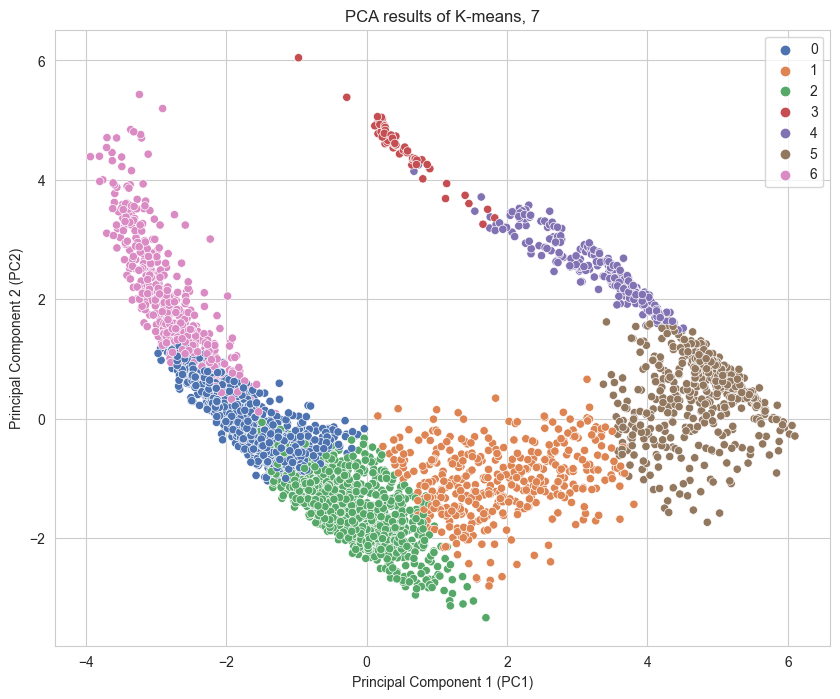

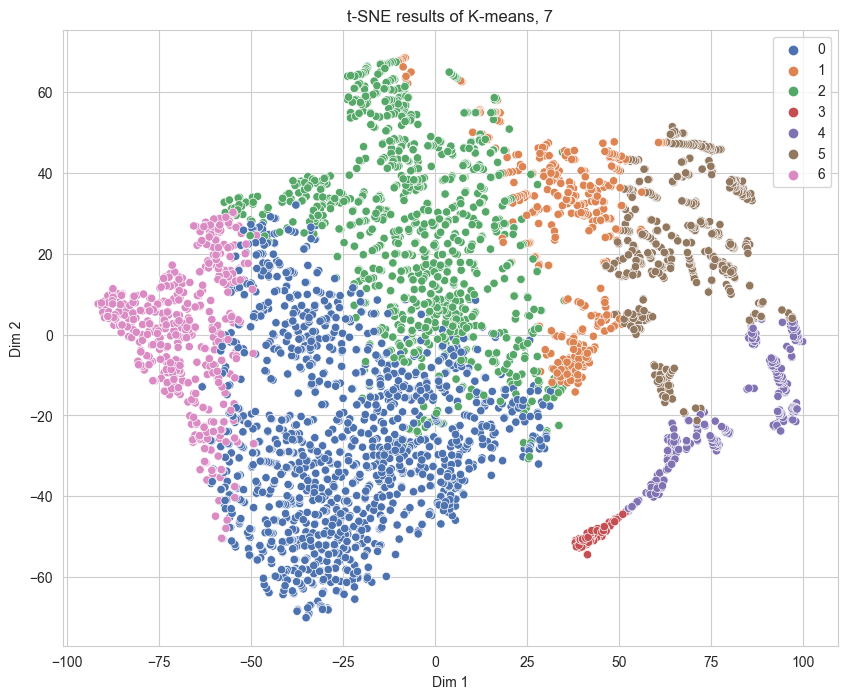

In [23]:
visualize_clusters(model, "K-means, 7")

In [24]:
visualize_clusters_3d_pca(model, "K-means, 7")

In [25]:
visualize_clusters_3d_tsne(model, "K-means, 7")

# K-means 15

In [116]:
model = KMeans(n_clusters=15, random_state=0, n_init=100).fit(data_embed)
show_clustering_metrics(data_embed, model)

Silhouette Score (MORE): 0.15290536422047427
Davies-Bouldin Index (LESS): 1.5884224086514465
Calinski-Harabasz Index (MORE): 1275.1856150185065
WCSS (LESS): 8969.770042011103


Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_44 (Dense)            (None, 48)                36912     
                                                                 
 dense_45 (Dense)            (None, 48)                2352      
                                                                 
 dense_46 (Dense)            (None, 48)                2352      
                                                                 
 dense_47 (Dense)            (None, 15)                735       
                                                                 
Total params: 42,351
Trainable params: 42,351
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==============================] - 1s 5ms/step - loss: 2.0094 - accuracy: 0.3540
Epoch 2/100
134/134 [==============================] - 1s 4ms/step - loss: 0.904

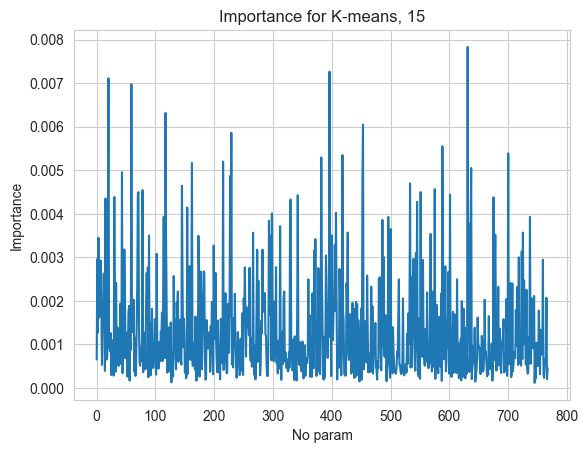

In [117]:
ann_model = Sequential([
    Dense(48, activation='relu', input_shape=(768,)),
    Dense(48, activation='relu'),
    Dense(48, activation='relu'),
    Dense(15, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(model.labels_), epochs=100)
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 15"
)

In [118]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
631,var_631,0.007831,0.007831
396,var_396,0.007262,0.015092
20,var_20,0.007110,0.022203
59,var_59,0.006971,0.029173
117,var_117,0.006317,0.035490
453,var_453,0.006048,0.041538
229,var_229,0.005859,0.047397
588,var_588,0.005550,0.052947
700,var_700,0.005387,0.058334
418,var_418,0.005347,0.063681


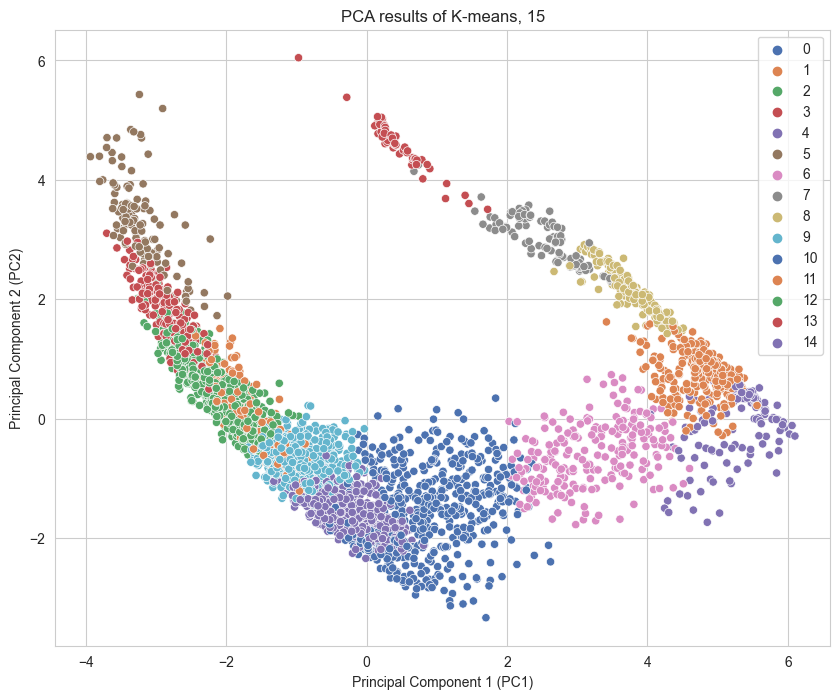

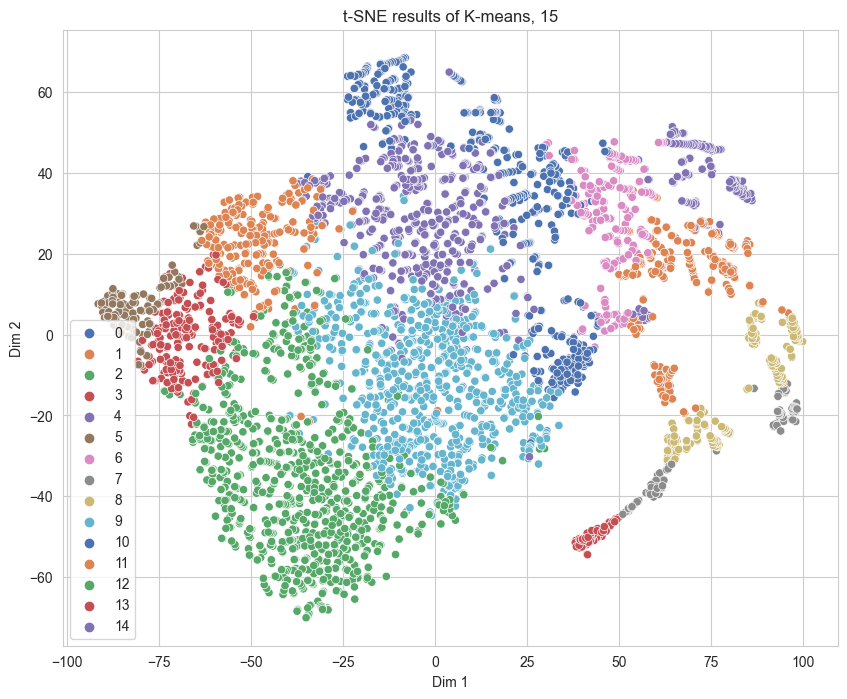

In [55]:
visualize_clusters(model, "K-means, 15")

In [56]:
visualize_clusters_3d_pca(model, "K-means, 15")

In [57]:
visualize_clusters_3d_tsne(model, "K-means, 15")

# DBSCAN, Euclidean, epsilon=0.75, min_samples=10

In [17]:
cl_metric = "euclidean"
min_samples = 10

dbscan_fits = []
dbscan_num_clusters = []
dbscan_num_noises = []
epsilons = np.arange(0.01, 2.01, 0.01)

for epsilon in tqdm(epsilons):
    dbscan_model = DBSCAN(eps=epsilon, min_samples=min_samples, metric=cl_metric).fit(data_embed)
    dbscan_fits.append(dbscan_model)

    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(dbscan_model.labels_)) - (1 if -1 in dbscan_model.labels_ else 0)
    n_noise_ = list(dbscan_model.labels_).count(-1)

    dbscan_num_clusters.append(n_clusters_)
    dbscan_num_noises.append(n_noise_)

100%|██████████| 200/200 [01:00<00:00,  3.31it/s]


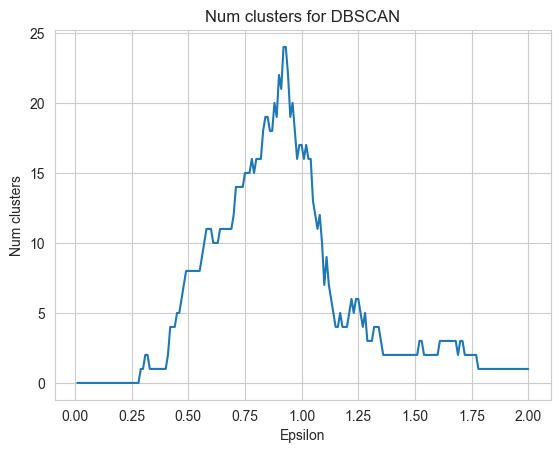

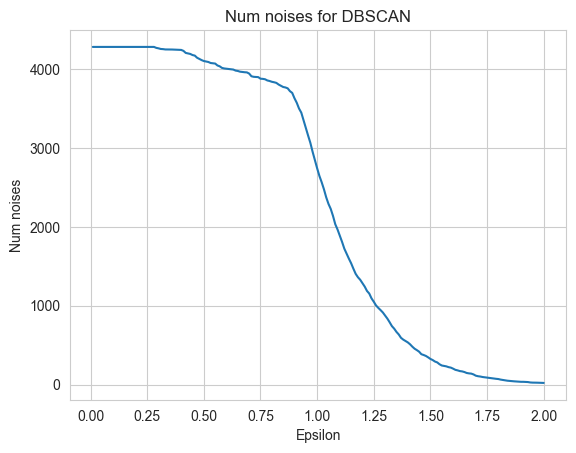

In [18]:
draw_metrics(epsilons, dbscan_num_clusters, xlabel="Epsilon", ylabel="Num clusters", title="DBSCAN")
draw_metrics(epsilons, dbscan_num_noises, xlabel="Epsilon", ylabel="Num noises", title="DBSCAN")

In [21]:
silhouette_scores = [silhouette_score(data_embed, dbscan_model_.labels_)
                     if len(set(dbscan_model_.labels_)) > 1 else 0 for dbscan_model_ in dbscan_fits]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, dbscan_model_.labels_)
                          if len(set(dbscan_model_.labels_)) > 1 else 0 for dbscan_model_ in dbscan_fits]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, dbscan_model_.labels_)
                             if len(set(dbscan_model_.labels_)) > 1 else 0 for dbscan_model_ in dbscan_fits]
wcss_metrics = [wcss_metric(data_embed, dbscan_model_.labels_)
                for dbscan_model_ in dbscan_fits]

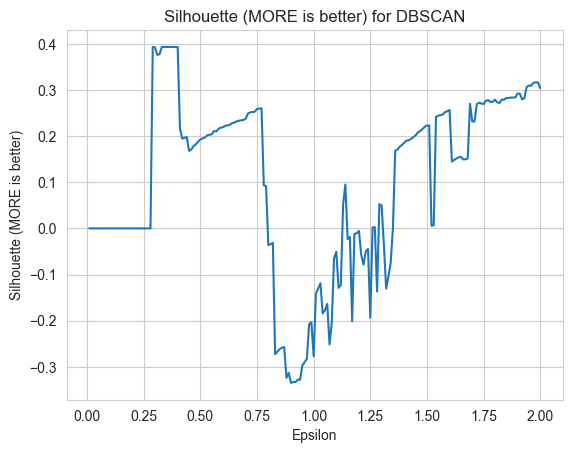

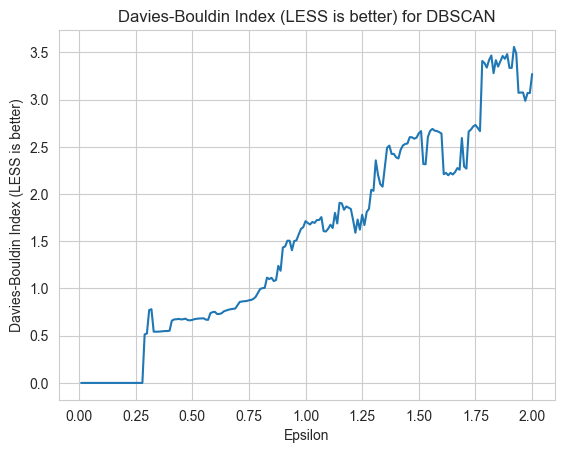

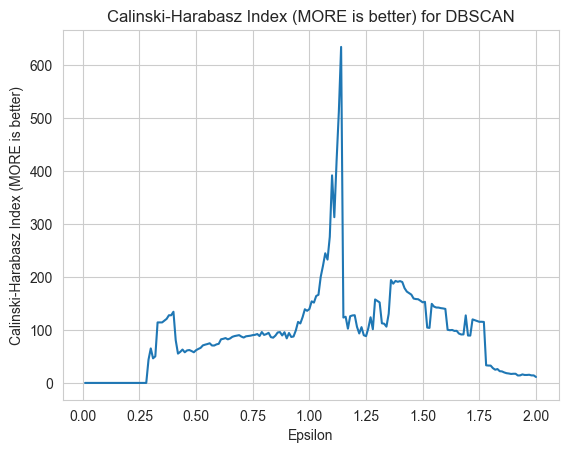

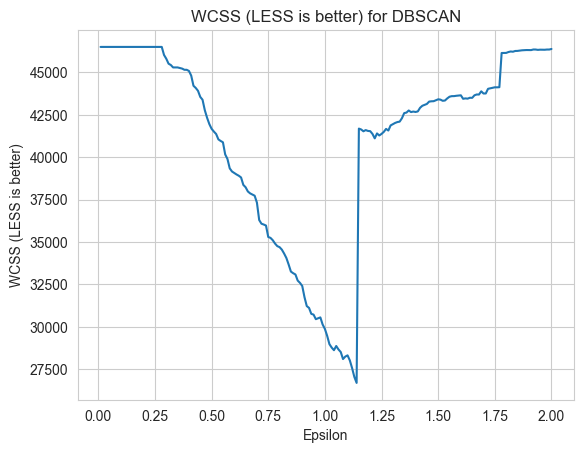

In [22]:
draw_metrics(epsilons, silhouette_scores, xlabel="Epsilon", ylabel="Silhouette (MORE is better)", title="DBSCAN")
draw_metrics(epsilons, davies_bouldin_indexes, xlabel="Epsilon", ylabel="Davies-Bouldin Index (LESS is better)",
             title="DBSCAN")
draw_metrics(epsilons, calinski_harabasz_indexes, xlabel="Epsilon", ylabel="Calinski-Harabasz Index (MORE is better)",
             title="DBSCAN")
draw_metrics(epsilons, wcss_metrics, xlabel="Epsilon", ylabel="WCSS (LESS is better)", title="DBSCAN")

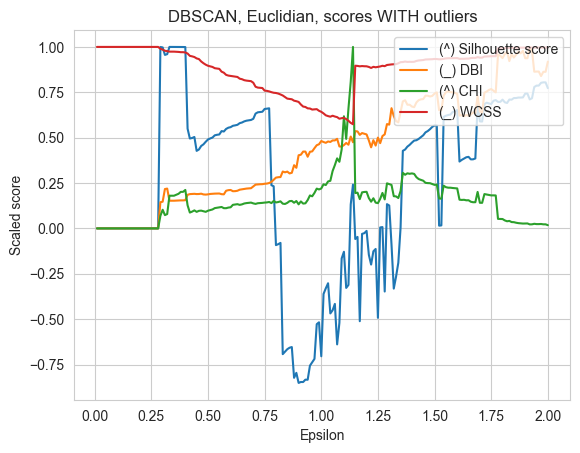

In [24]:
draw_metrics_many_norm(
    epsilons,
    {
        "(^) Silhouette score": silhouette_scores,
        "(_) DBI": davies_bouldin_indexes,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Epsilon",
    ylabel="Scaled score",
    title="DBSCAN, Euclidian, scores WITH outliers",
)

In [25]:
silhouette_scores = []
davies_bouldin_indexes = []
calinski_harabasz_indexes = []
wcss_metrics = []

for dbscan_model_ in tqdm(dbscan_fits):
    cl_labels = dbscan_model_.labels_

    data_embed_testing = data_embed.copy(deep=True)
    data_embed_testing["cluster"] = cl_labels
    data_embed_testing = data_embed_testing[data_embed_testing["cluster"] != -1]
    cl_labels_testing = data_embed_testing["cluster"]
    data_embed_testing = data_embed_testing.drop(["cluster"], axis=1).reset_index(drop=True)

    if len(set(cl_labels)) == 1 and -1 in cl_labels:
        silhouette_scores.append(0.0)
        davies_bouldin_indexes.append(0.0)
        calinski_harabasz_indexes.append(0.0)
        wcss_metrics.append(0.0)
    elif len(set(cl_labels)) == 2 and -1 in cl_labels:
        silhouette_scores.append(0.0)
        davies_bouldin_indexes.append(0.0)
        calinski_harabasz_indexes.append(0.0)
        wcss_metrics.append(wcss_metric(data_embed_testing, cl_labels_testing))
    else:
        silhouette_scores.append(silhouette_score(data_embed_testing, cl_labels_testing))
        davies_bouldin_indexes.append(davies_bouldin_score(data_embed_testing, cl_labels_testing))
        calinski_harabasz_indexes.append(calinski_harabasz_score(data_embed_testing, cl_labels_testing))
        wcss_metrics.append(wcss_metric(data_embed_testing, cl_labels_testing))

100%|██████████| 200/200 [02:34<00:00,  1.29it/s]


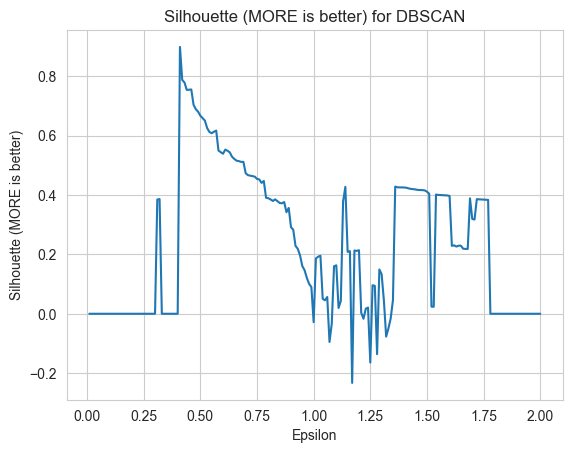

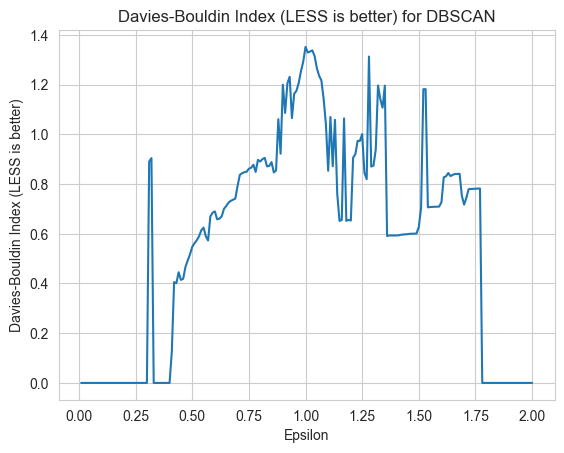

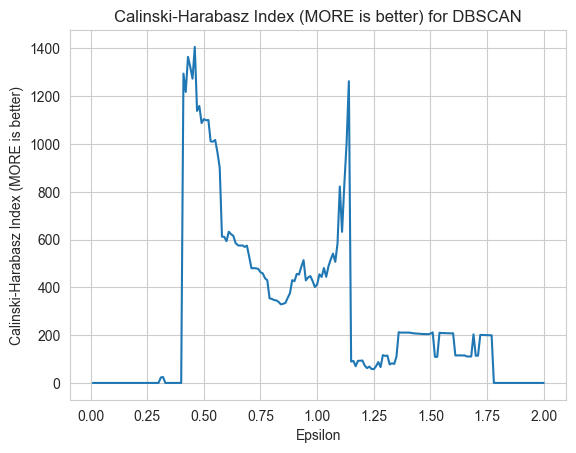

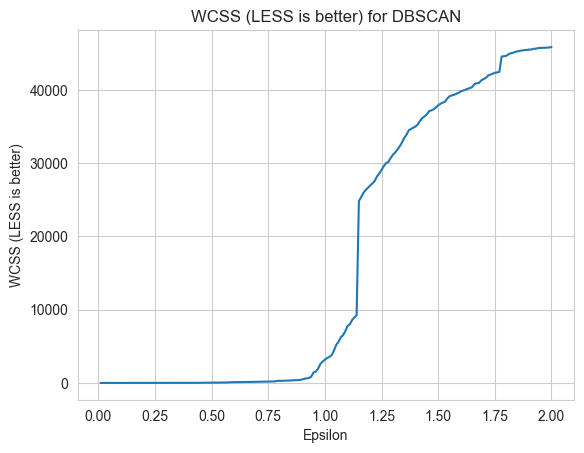

In [27]:
draw_metrics(epsilons, silhouette_scores, xlabel="Epsilon", ylabel="Silhouette (MORE is better)", title="DBSCAN")
draw_metrics(epsilons, davies_bouldin_indexes, xlabel="Epsilon", ylabel="Davies-Bouldin Index (LESS is better)",
             title="DBSCAN")
draw_metrics(epsilons, calinski_harabasz_indexes, xlabel="Epsilon", ylabel="Calinski-Harabasz Index (MORE is better)",
             title="DBSCAN")
draw_metrics(epsilons, wcss_metrics, xlabel="Epsilon", ylabel="WCSS (LESS is better)", title="DBSCAN")

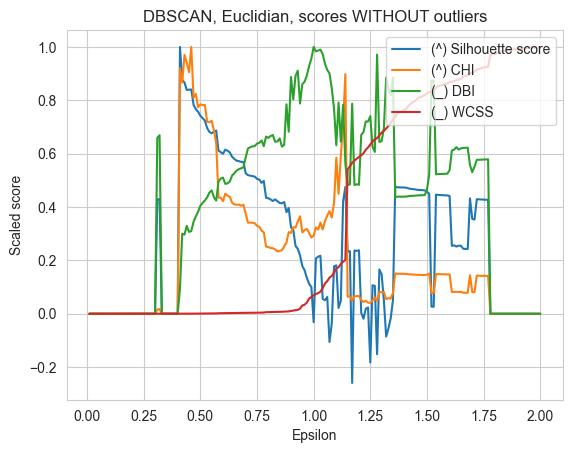

In [29]:
draw_metrics_many_norm(
    epsilons,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Epsilon",
    ylabel="Scaled score",
    title="DBSCAN, Euclidian, scores WITHOUT outliers",
)

In [43]:
inx_ = 165
epsilons[inx_], dbscan_num_clusters[inx_]

(1.6600000000000001, 3)

In [119]:
cl_metric = "euclidean"
epsilon = 1.25
min_samples = 10

dbscan_model = DBSCAN(eps=epsilon, min_samples=min_samples, metric=cl_metric).fit(data_embed)

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(dbscan_model.labels_)) - (1 if -1 in dbscan_model.labels_ else 0)
n_noise_ = list(dbscan_model.labels_).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

print(len(set(dbscan_model.labels_)))
show_clustering_metrics(data_embed, dbscan_model)

Estimated number of clusters: 6
Estimated number of noise points: 1051
7
Silhouette Score (MORE): -0.19387778869238054
Davies-Bouldin Index (LESS): 1.779761421373756
Calinski-Harabasz Index (MORE): 88.31341994548592
WCSS (LESS): 41370.372799525234


Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_53 (Dense)            (None, 128)               98432     
                                                                 
 dense_54 (Dense)            (None, 128)               16512     
                                                                 
 dense_55 (Dense)            (None, 128)               16512     
                                                                 
 dense_56 (Dense)            (None, 128)               16512     
                                                                 
 dense_57 (Dense)            (None, 7)                 903       
                                                                 
Total params: 148,871
Trainable params: 148,871
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==========================

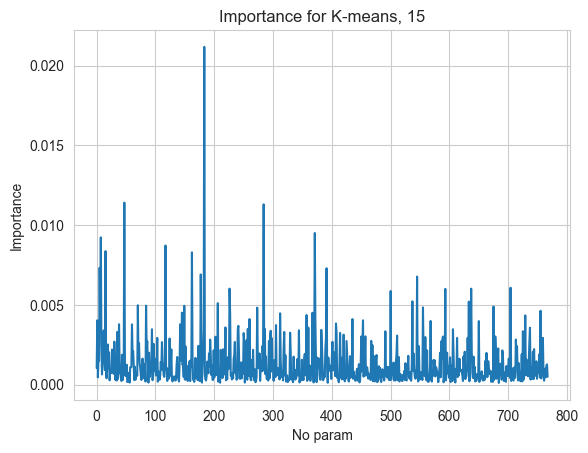

In [121]:
ann_model = Sequential([
    Dense(128, activation='relu', input_shape=(768,)),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(7, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(dbscan_model.labels_), epochs=100)
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(dbscan_model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 15"
)

In [122]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
183,var_183,0.021173,0.021173
47,var_47,0.011407,0.032580
284,var_284,0.011301,0.043881
371,var_371,0.009505,0.053385
7,var_7,0.009229,0.062615
117,var_117,0.008717,0.071332
15,var_15,0.008365,0.079697
162,var_162,0.008290,0.087987
5,var_5,0.007320,0.095307
391,var_391,0.007292,0.102599


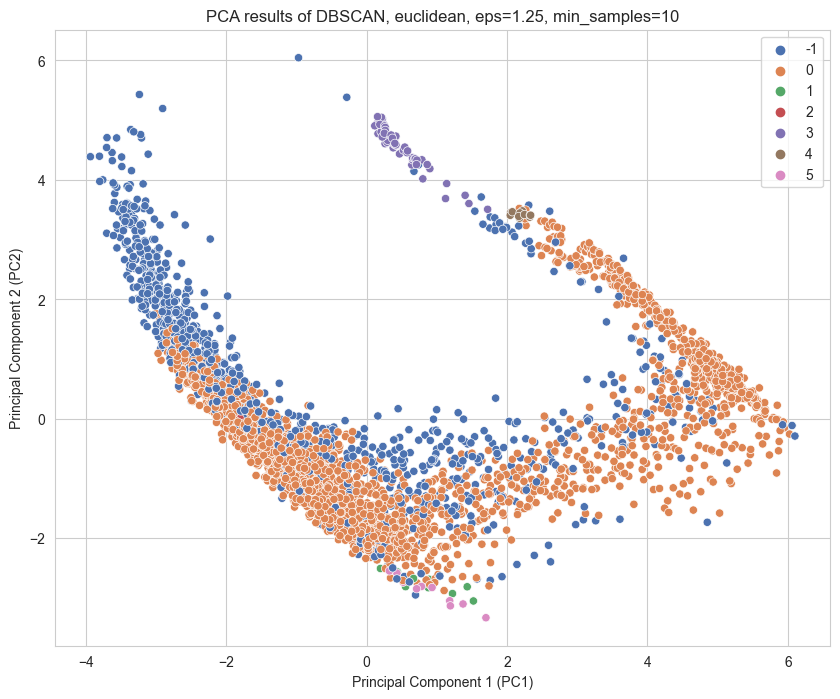

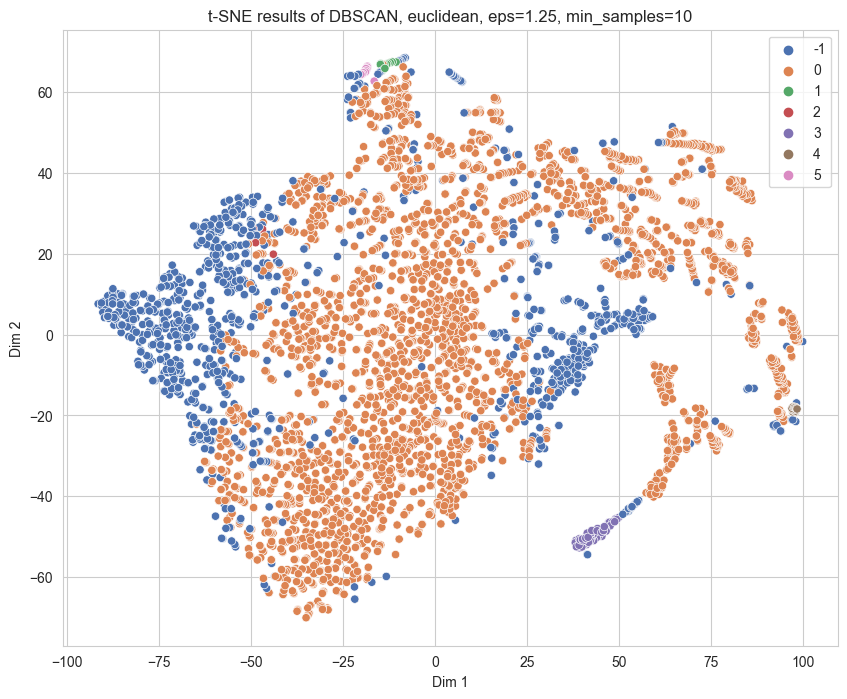

In [40]:
visualize_clusters(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [41]:
visualize_clusters_3d_pca(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [42]:
visualize_clusters_3d_tsne(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [123]:
cl_metric = "euclidean"
epsilon = 1.66
min_samples = 10

dbscan_model = DBSCAN(eps=epsilon, min_samples=min_samples, metric=cl_metric).fit(data_embed)

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(dbscan_model.labels_)) - (1 if -1 in dbscan_model.labels_ else 0)
n_noise_ = list(dbscan_model.labels_).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

print(len(set(dbscan_model.labels_)))
show_clustering_metrics(data_embed, dbscan_model)

Estimated number of clusters: 3
Estimated number of noise points: 148
4
Silhouette Score (MORE): 0.14966308817369284
Davies-Bouldin Index (LESS): 2.2321446233270983
Calinski-Harabasz Index (MORE): 93.23648697653364
WCSS (LESS): 43644.55316566733


Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_58 (Dense)            (None, 128)               98432     
                                                                 
 dense_59 (Dense)            (None, 128)               16512     
                                                                 
 dense_60 (Dense)            (None, 128)               16512     
                                                                 
 dense_61 (Dense)            (None, 128)               16512     
                                                                 
 dense_62 (Dense)            (None, 4)                 516       
                                                                 
Total params: 148,484
Trainable params: 148,484
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==========================

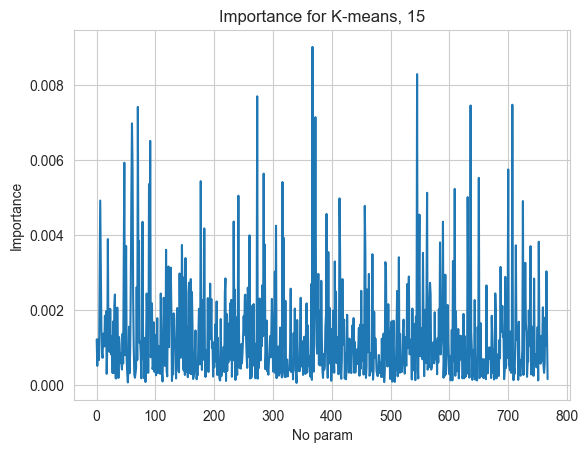

In [124]:
ann_model = Sequential([
    Dense(128, activation='relu', input_shape=(768,)),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(4, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(dbscan_model.labels_), epochs=100)
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(dbscan_model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 15"
)

In [125]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
367,var_367,0.009021,0.009021
545,var_545,0.008296,0.017318
273,var_273,0.007705,0.025023
707,var_707,0.007481,0.032503
636,var_636,0.007461,0.039964
70,var_70,0.007422,0.047386
372,var_372,0.007150,0.054536
60,var_60,0.006984,0.061520
91,var_91,0.006517,0.068037
47,var_47,0.005934,0.073972


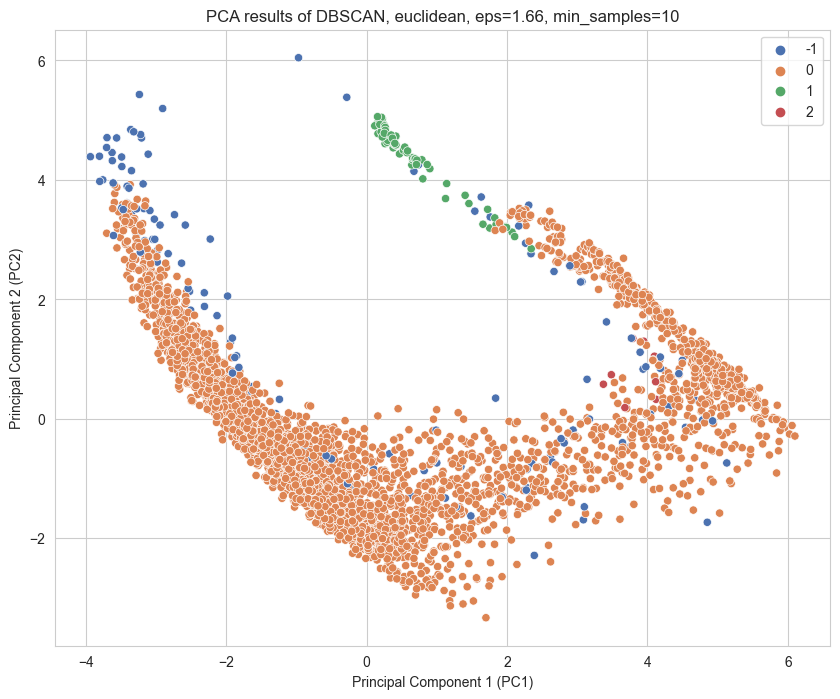

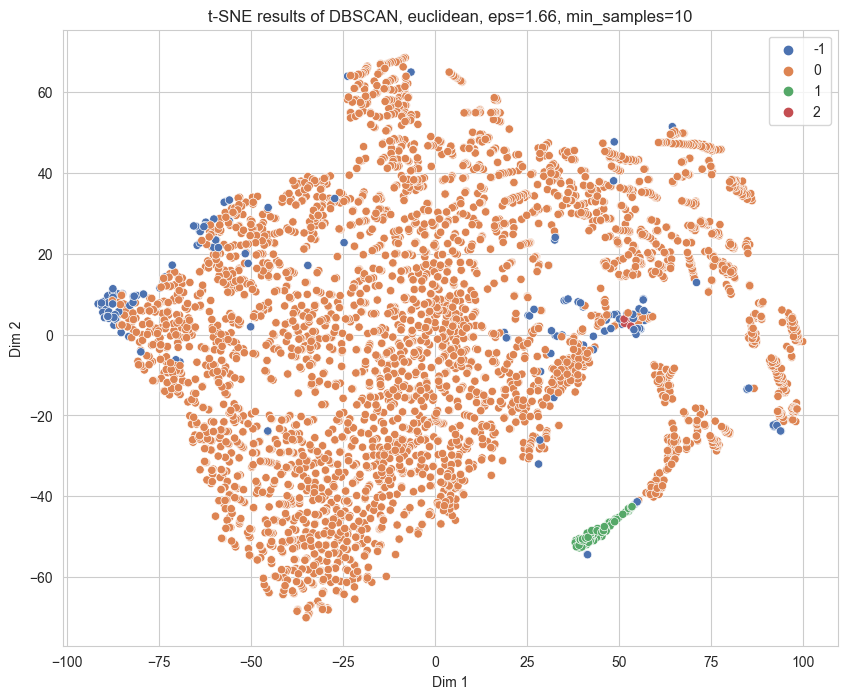

In [45]:
visualize_clusters(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [46]:
visualize_clusters_3d_pca(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [47]:
visualize_clusters_3d_tsne(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

# DBSCAN, cosine dist,

In [30]:
cl_metric = "cosine"
min_samples = 10

dbscan_fits = []
dbscan_num_clusters = []
dbscan_num_noises = []
epsilons = np.arange(0.00005, 0.01, 0.00005)

for epsilon in tqdm(epsilons):
    dbscan_model = DBSCAN(eps=epsilon, min_samples=min_samples, metric=cl_metric).fit(data_embed)
    dbscan_fits.append(dbscan_model)

    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(dbscan_model.labels_)) - (1 if -1 in dbscan_model.labels_ else 0)
    n_noise_ = list(dbscan_model.labels_).count(-1)

    dbscan_num_clusters.append(n_clusters_)
    dbscan_num_noises.append(n_noise_)

100%|██████████| 199/199 [01:29<00:00,  2.21it/s]


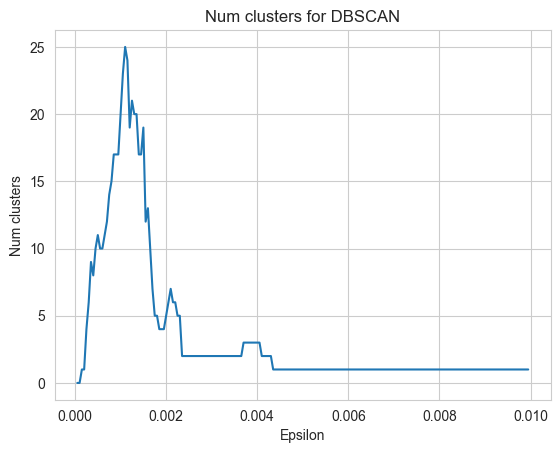

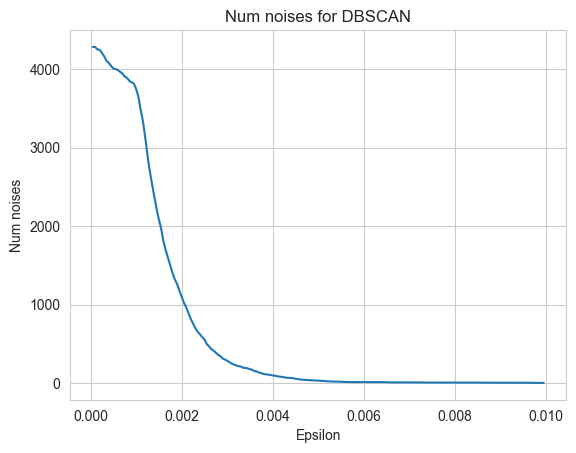

In [31]:
draw_metrics(epsilons, dbscan_num_clusters, xlabel="Epsilon", ylabel="Num clusters", title="DBSCAN")
draw_metrics(epsilons, dbscan_num_noises, xlabel="Epsilon", ylabel="Num noises", title="DBSCAN")

In [32]:
silhouette_scores = [silhouette_score(data_embed, dbscan_model_.labels_)
                     if len(set(dbscan_model_.labels_)) > 1 else 0 for dbscan_model_ in dbscan_fits]
silhouette_scores_cos = [silhouette_score(data_embed, dbscan_model_.labels_, metric="cosine")
                         if len(set(dbscan_model_.labels_)) > 1 else 0 for dbscan_model_ in dbscan_fits]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, dbscan_model_.labels_)
                          if len(set(dbscan_model_.labels_)) > 1 else 0 for dbscan_model_ in dbscan_fits]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, dbscan_model_.labels_)
                             if len(set(dbscan_model_.labels_)) > 1 else 0 for dbscan_model_ in dbscan_fits]
wcss_metrics = [wcss_metric(data_embed, dbscan_model_.labels_)
                for dbscan_model_ in dbscan_fits]

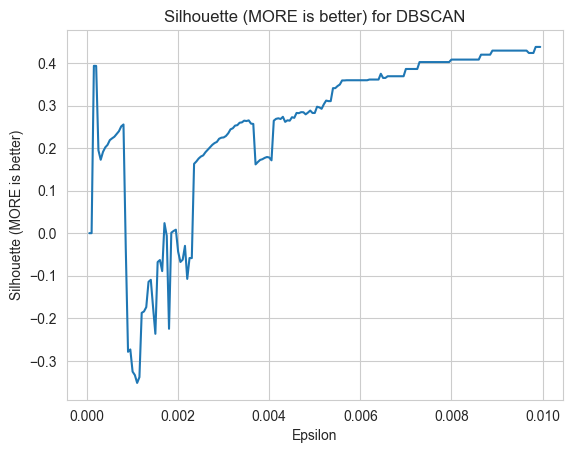

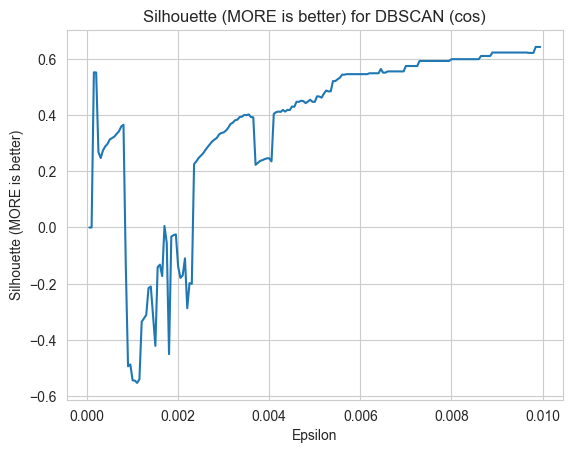

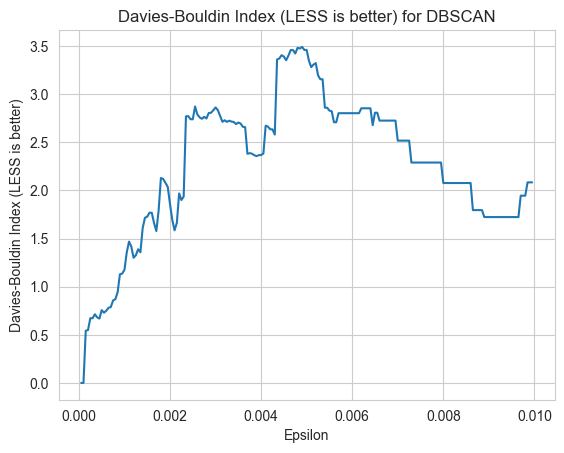

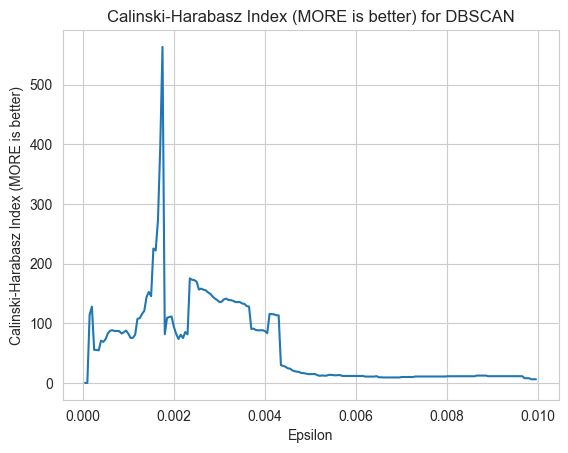

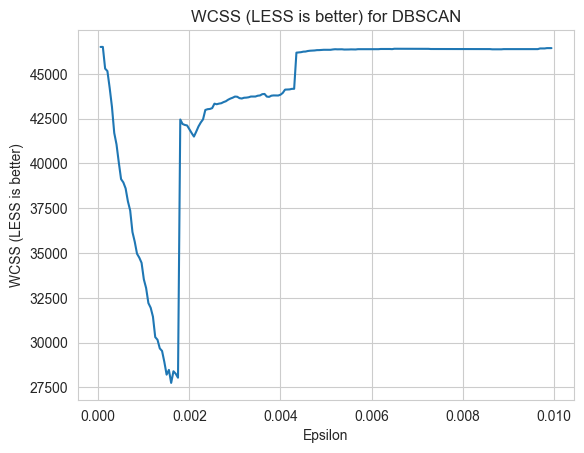

In [33]:
draw_metrics(epsilons, silhouette_scores, xlabel="Epsilon", ylabel="Silhouette (MORE is better)", title="DBSCAN")
draw_metrics(epsilons, silhouette_scores_cos, xlabel="Epsilon", ylabel="Silhouette (MORE is better)",
             title="DBSCAN (cos)")
draw_metrics(epsilons, davies_bouldin_indexes, xlabel="Epsilon", ylabel="Davies-Bouldin Index (LESS is better)",
             title="DBSCAN")
draw_metrics(epsilons, calinski_harabasz_indexes, xlabel="Epsilon", ylabel="Calinski-Harabasz Index (MORE is better)",
             title="DBSCAN")
draw_metrics(epsilons, wcss_metrics, xlabel="Epsilon", ylabel="WCSS (LESS is better)", title="DBSCAN")

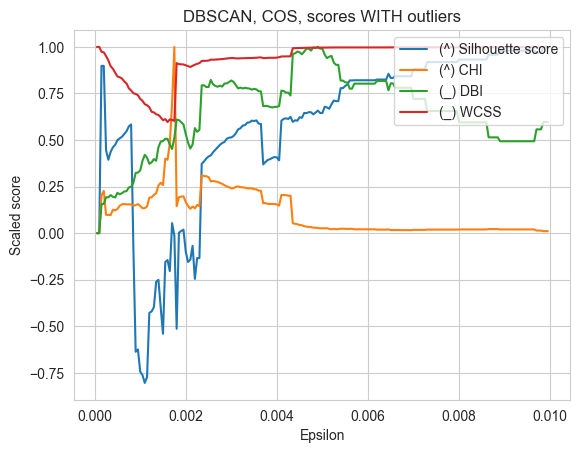

In [34]:
draw_metrics_many_norm(
    epsilons,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Epsilon",
    ylabel="Scaled score",
    title="DBSCAN, COS, scores WITH outliers",
)

In [35]:
silhouette_scores = []
silhouette_scores_cos = []
davies_bouldin_indexes = []
calinski_harabasz_indexes = []
wcss_metrics = []

for dbscan_model_ in tqdm(dbscan_fits):
    cl_labels = dbscan_model_.labels_

    data_embed_testing = data_embed.copy(deep=True)
    data_embed_testing["cluster"] = cl_labels
    data_embed_testing = data_embed_testing[data_embed_testing["cluster"] != -1]
    cl_labels_testing = data_embed_testing["cluster"]
    data_embed_testing = data_embed_testing.drop(["cluster"], axis=1).reset_index(drop=True)

    if len(set(cl_labels)) == 1 and -1 in cl_labels:
        silhouette_scores.append(0.0)
        silhouette_scores_cos.append(0.0)
        davies_bouldin_indexes.append(0.0)
        calinski_harabasz_indexes.append(0.0)
        wcss_metrics.append(0.0)
    elif len(set(cl_labels)) == 2 and -1 in cl_labels:
        silhouette_scores.append(0.0)
        silhouette_scores_cos.append(0.0)
        davies_bouldin_indexes.append(0.0)
        calinski_harabasz_indexes.append(0.0)
        wcss_metrics.append(wcss_metric(data_embed_testing, cl_labels_testing))
    else:
        silhouette_scores.append(silhouette_score(data_embed_testing, cl_labels_testing))
        silhouette_scores_cos.append(silhouette_score(data_embed_testing, cl_labels_testing, metric="cosine"))
        davies_bouldin_indexes.append(davies_bouldin_score(data_embed_testing, cl_labels_testing))
        calinski_harabasz_indexes.append(calinski_harabasz_score(data_embed_testing, cl_labels_testing))
        wcss_metrics.append(wcss_metric(data_embed_testing, cl_labels_testing))

100%|██████████| 199/199 [04:23<00:00,  1.33s/it]


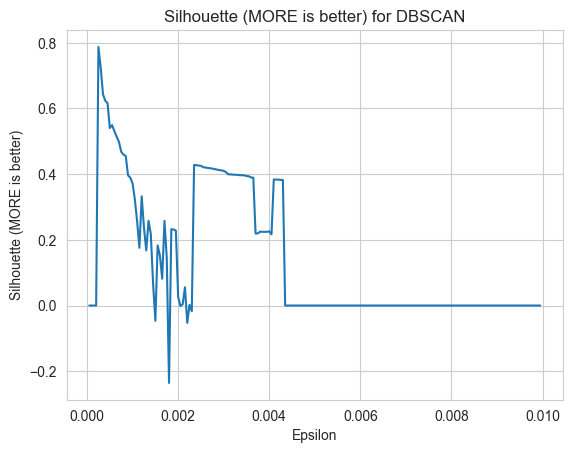

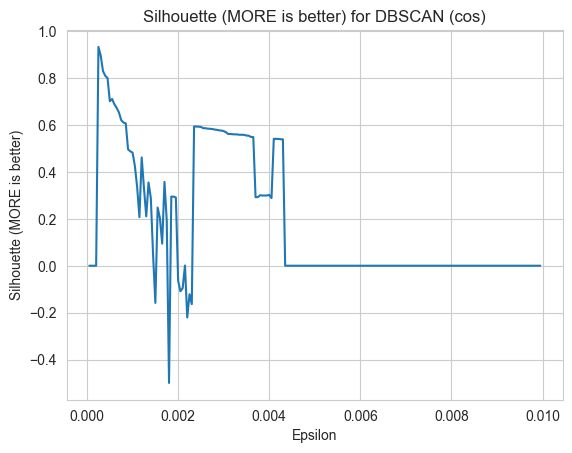

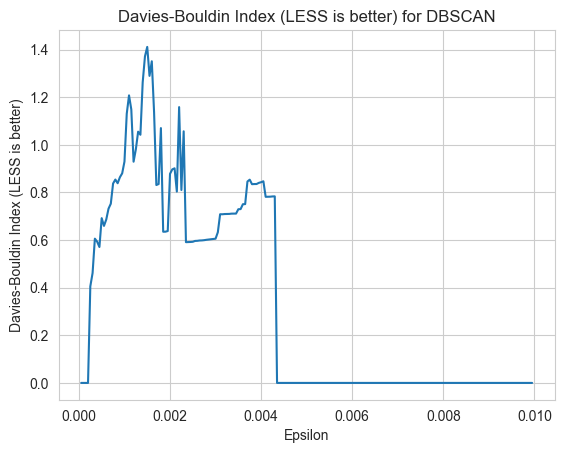

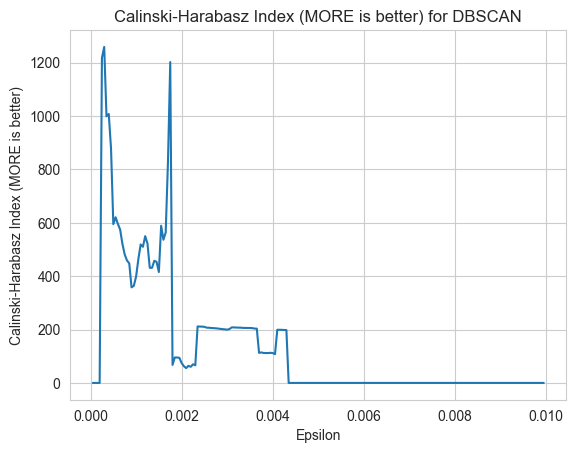

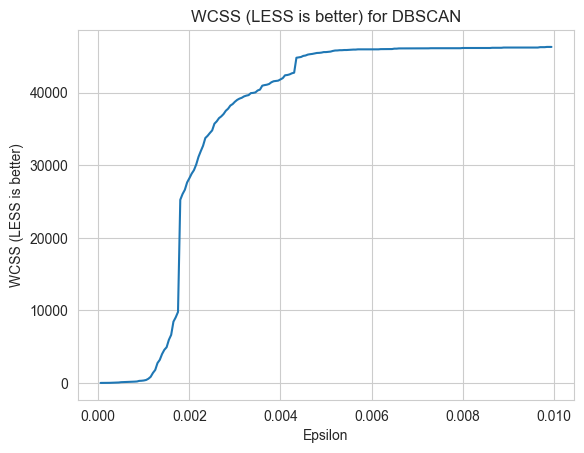

In [36]:
draw_metrics(epsilons, silhouette_scores, xlabel="Epsilon", ylabel="Silhouette (MORE is better)", title="DBSCAN")
draw_metrics(epsilons, silhouette_scores_cos, xlabel="Epsilon", ylabel="Silhouette (MORE is better)",
             title="DBSCAN (cos)")
draw_metrics(epsilons, davies_bouldin_indexes, xlabel="Epsilon", ylabel="Davies-Bouldin Index (LESS is better)",
             title="DBSCAN")
draw_metrics(epsilons, calinski_harabasz_indexes, xlabel="Epsilon", ylabel="Calinski-Harabasz Index (MORE is better)",
             title="DBSCAN")
draw_metrics(epsilons, wcss_metrics, xlabel="Epsilon", ylabel="WCSS (LESS is better)", title="DBSCAN")

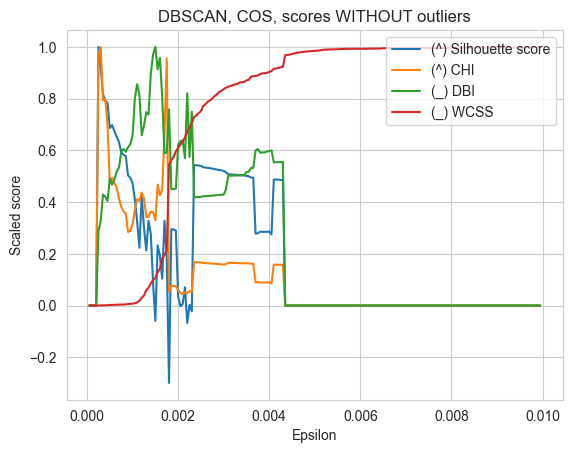

In [37]:
draw_metrics_many_norm(
    epsilons,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Epsilon",
    ylabel="Scaled score",
    title="DBSCAN, COS, scores WITHOUT outliers",
)

In [67]:
inx_ = 35
epsilons[inx_], dbscan_num_clusters[inx_]

(0.0018, 5)

In [126]:
cl_metric = "cosine"
epsilon = 0.0018
min_samples = 10

dbscan_model = DBSCAN(eps=epsilon, min_samples=min_samples, metric=cl_metric).fit(data_embed)

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(dbscan_model.labels_)) - (1 if -1 in dbscan_model.labels_ else 0)
n_noise_ = list(dbscan_model.labels_).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

print(len(set(dbscan_model.labels_)))
show_clustering_metrics(data_embed, dbscan_model)

Estimated number of clusters: 5
Estimated number of noise points: 1403
6
Silhouette Score (MORE): -0.224838638596601
Davies-Bouldin Index (LESS): 2.128373422030919
Calinski-Harabasz Index (MORE): 81.60929905660616
WCSS (LESS): 42447.52837772266


Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_63 (Dense)            (None, 128)               98432     
                                                                 
 dense_64 (Dense)            (None, 128)               16512     
                                                                 
 dense_65 (Dense)            (None, 128)               16512     
                                                                 
 dense_66 (Dense)            (None, 128)               16512     
                                                                 
 dense_67 (Dense)            (None, 6)                 774       
                                                                 
Total params: 148,742
Trainable params: 148,742
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==========================

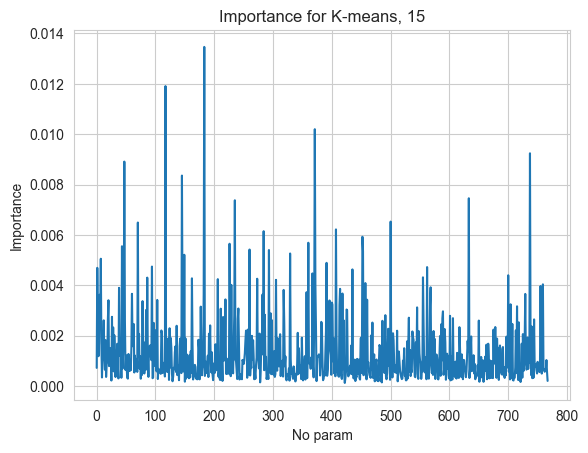

In [127]:
ann_model = Sequential([
    Dense(128, activation='relu', input_shape=(768,)),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(6, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(dbscan_model.labels_), epochs=100)
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(dbscan_model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 15"
)

In [128]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
183,var_183,0.013466,0.013466
117,var_117,0.011909,0.025375
371,var_371,0.010198,0.035573
737,var_737,0.009240,0.044813
47,var_47,0.008910,0.053723
145,var_145,0.008356,0.062079
633,var_633,0.007454,0.069533
235,var_235,0.007374,0.076907
500,var_500,0.006527,0.083434
70,var_70,0.006490,0.089924


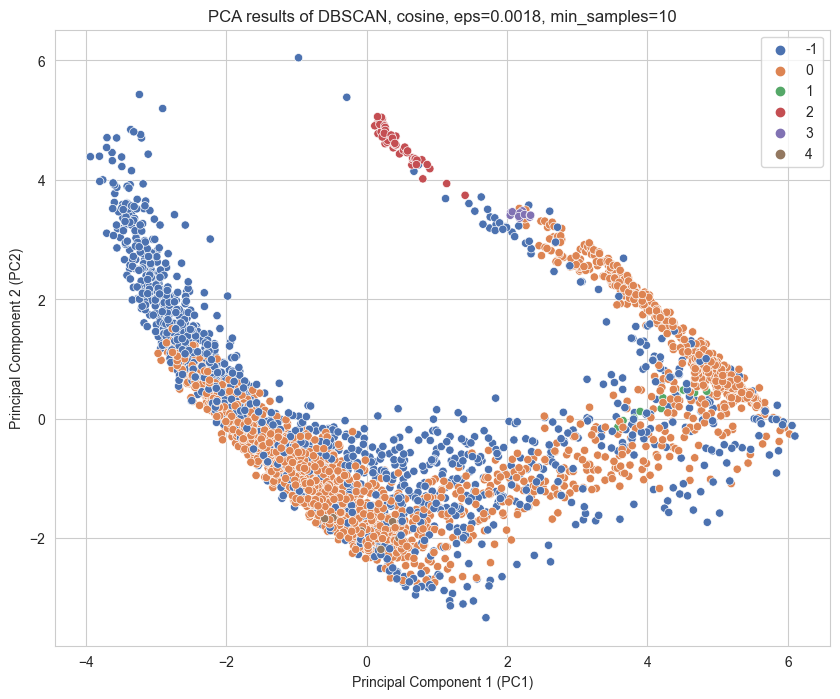

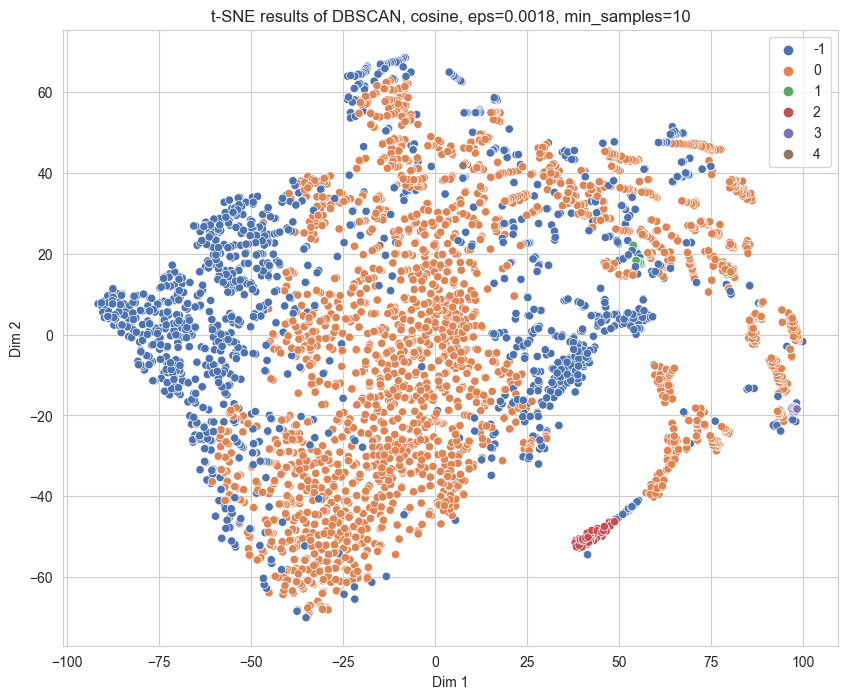

In [69]:
visualize_clusters(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [70]:
visualize_clusters_3d_pca(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [71]:
visualize_clusters_3d_tsne(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [73]:
inx_ = 40
epsilons[inx_], dbscan_num_clusters[inx_]

(0.00205, 6)

In [129]:
cl_metric = "cosine"
epsilon = 0.00205
min_samples = 10

dbscan_model = DBSCAN(eps=epsilon, min_samples=min_samples, metric=cl_metric).fit(data_embed)

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(dbscan_model.labels_)) - (1 if -1 in dbscan_model.labels_ else 0)
n_noise_ = list(dbscan_model.labels_).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

print(len(set(dbscan_model.labels_)))
show_clustering_metrics(data_embed, dbscan_model)

Estimated number of clusters: 6
Estimated number of noise points: 1025
7
Silhouette Score (MORE): -0.0677653532838145
Davies-Bouldin Index (LESS): 1.693306440520821
Calinski-Harabasz Index (MORE): 82.18722160628676
WCSS (LESS): 41689.294637256884


Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_68 (Dense)            (None, 128)               98432     
                                                                 
 dense_69 (Dense)            (None, 128)               16512     
                                                                 
 dense_70 (Dense)            (None, 128)               16512     
                                                                 
 dense_71 (Dense)            (None, 128)               16512     
                                                                 
 dense_72 (Dense)            (None, 7)                 903       
                                                                 
Total params: 148,871
Trainable params: 148,871
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
134/134 [==========================

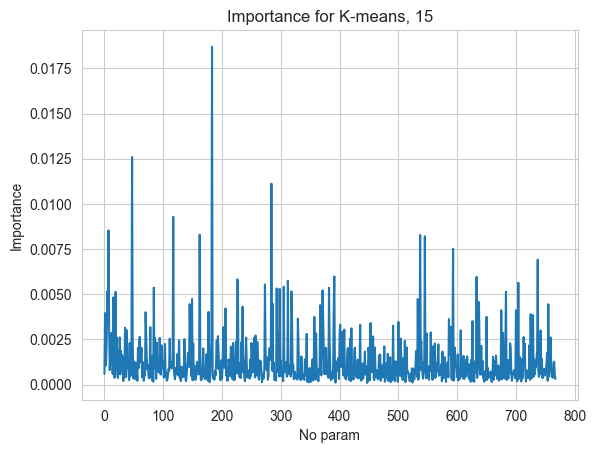

In [130]:
ann_model = Sequential([
    Dense(128, activation='relu', input_shape=(768,)),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(128, activation='relu'),
    Dense(7, activation='softmax')
])

ann_model.summary()

ann_model.compile(loss="categorical_crossentropy",
                  metrics=["accuracy", ], optimizer="adam")

ann_model.fit(data_embed, pd.get_dummies(dbscan_model.labels_), epochs=100)
loss_function = tf.keras.losses.categorical_crossentropy

with tf.GradientTape() as tape:
    inputs = tf.constant(data_embed, dtype=tf.float32)
    tape.watch(inputs)
    predictions = ann_model(inputs)
    loss = loss_function(pd.get_dummies(dbscan_model.labels_), predictions)

gradients = tape.gradient(loss, inputs)
feature_importance = tf.reduce_mean(tf.abs(gradients), axis=0)
print(feature_importance.numpy())
draw_metrics(
    range(len(feature_importance.numpy())),
    feature_importance.numpy() / np.sum(feature_importance.numpy()),
    ylabel="Importance", xlabel="No param", title="K-means, 15"
)

In [131]:
var_inf_df = pd.DataFrame({
    "var_no": [f"var_{var_no}" for var_no in range(768)],
    "inform": feature_importance.numpy() / np.sum(feature_importance.numpy()),
})

var_inf_df = var_inf_df.sort_values(by="inform", ascending=False)
var_inf_df["cum_inf"] = var_inf_df["inform"].cumsum()
var_inf_df.head(10)

,var_no,inform,cum_inf
183,var_183,0.018684,0.018684
47,var_47,0.012592,0.031276
284,var_284,0.011119,0.042395
117,var_117,0.009285,0.051680
7,var_7,0.008530,0.060210
162,var_162,0.008293,0.068503
537,var_537,0.008279,0.076782
545,var_545,0.008208,0.084990
593,var_593,0.007519,0.092509
737,var_737,0.006909,0.099418


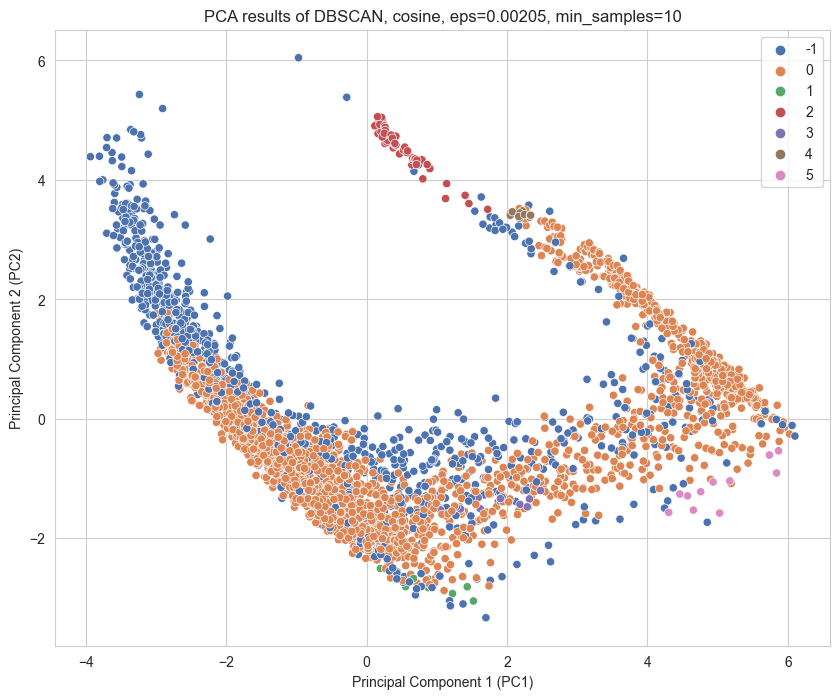

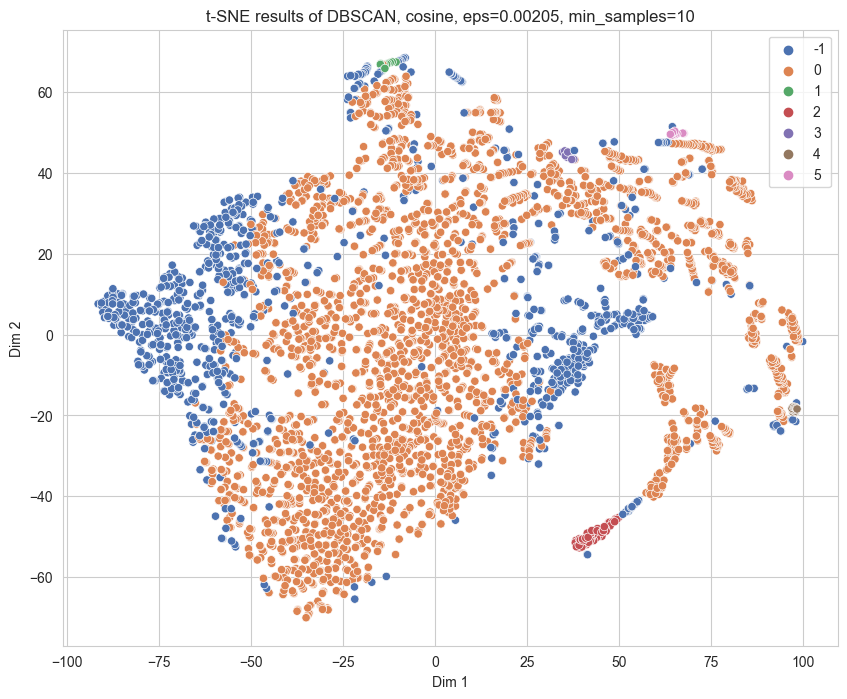

In [75]:
visualize_clusters(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [76]:
visualize_clusters_3d_pca(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

In [77]:
visualize_clusters_3d_tsne(dbscan_model, f"DBSCAN, {cl_metric}, eps={epsilon}, min_samples={min_samples}")

# Hierarchical Agglomerate Clustering, Euclidean

100%|██████████| 28/28 [00:37<00:00,  1.34s/it]


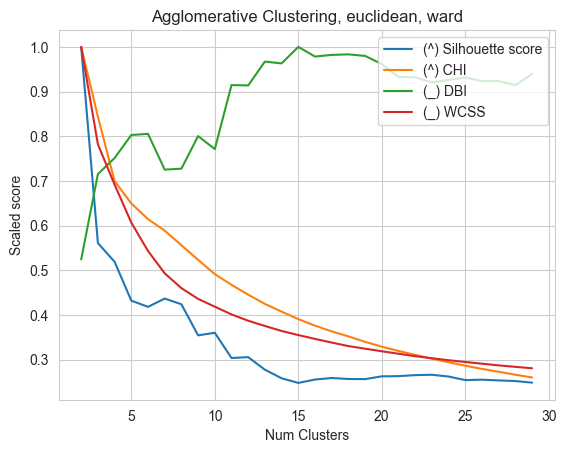

In [12]:
cl_metric = "euclidean"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "ward"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:39<00:00,  1.42s/it]


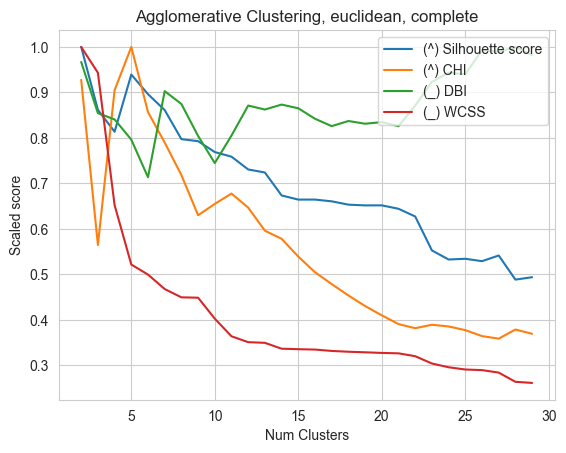

In [13]:
cl_metric = "euclidean"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "complete"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:40<00:00,  1.43s/it]


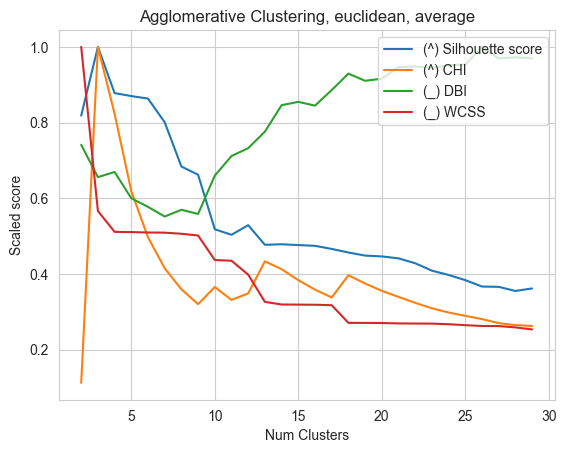

In [14]:
cl_metric = "euclidean"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "average"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:36<00:00,  1.31s/it]


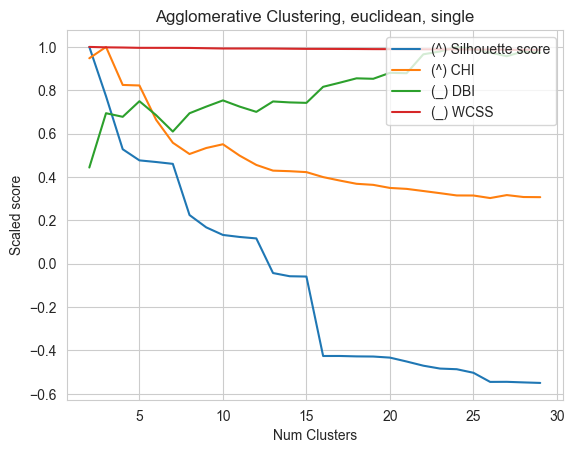

In [15]:
cl_metric = "euclidean"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "single"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

# Hierarchical Agglomerate Clustering, L1

100%|██████████| 28/28 [00:36<00:00,  1.32s/it]


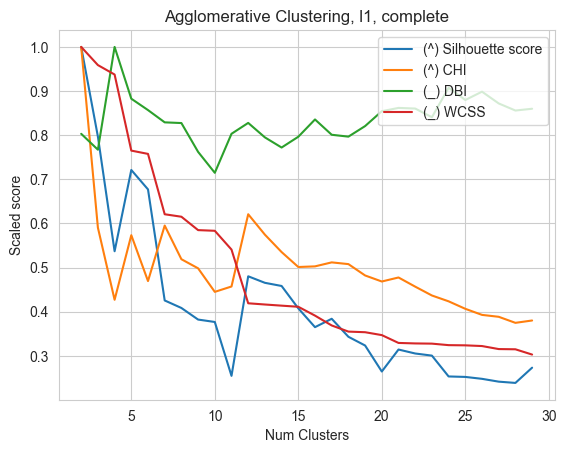

In [17]:
cl_metric = "l1"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "complete"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:36<00:00,  1.29s/it]


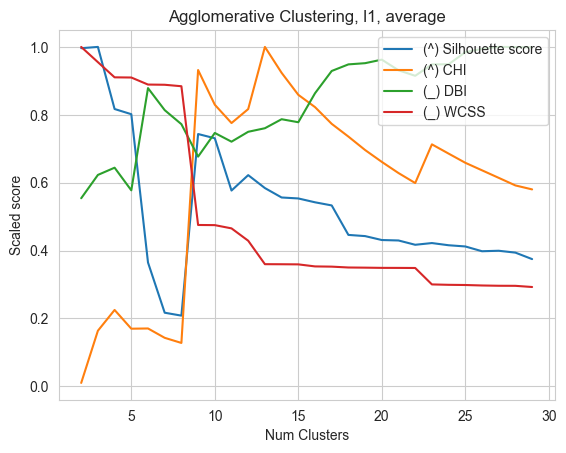

In [18]:
cl_metric = "l1"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "average"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:35<00:00,  1.25s/it]


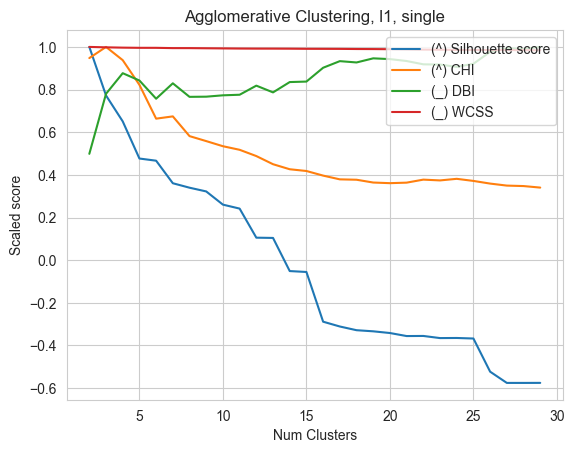

In [19]:
cl_metric = "l1"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "single"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

# Hierarchical Agglomerate Clustering, L2

100%|██████████| 28/28 [00:38<00:00,  1.36s/it]


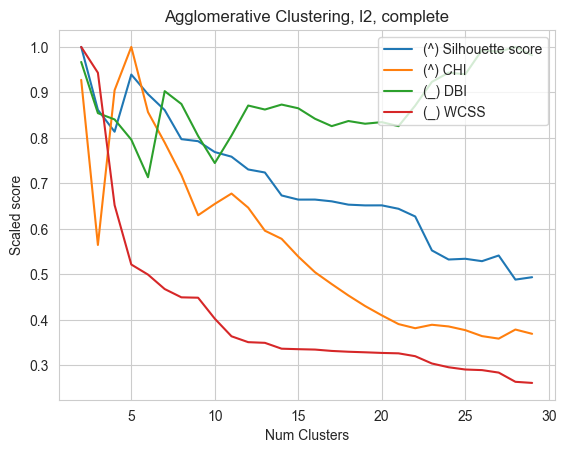

In [20]:
cl_metric = "l2"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "complete"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:36<00:00,  1.31s/it]


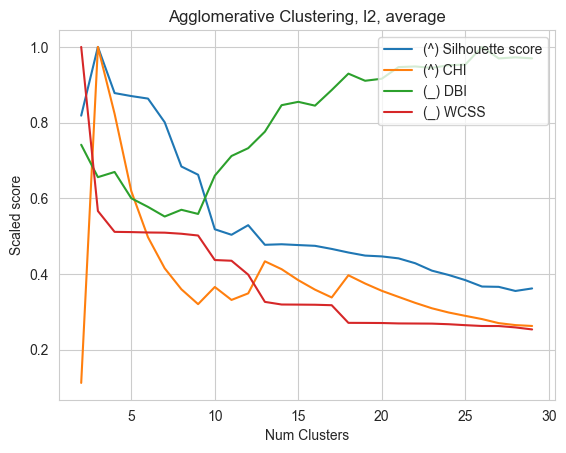

In [21]:
cl_metric = "l2"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "average"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:35<00:00,  1.27s/it]


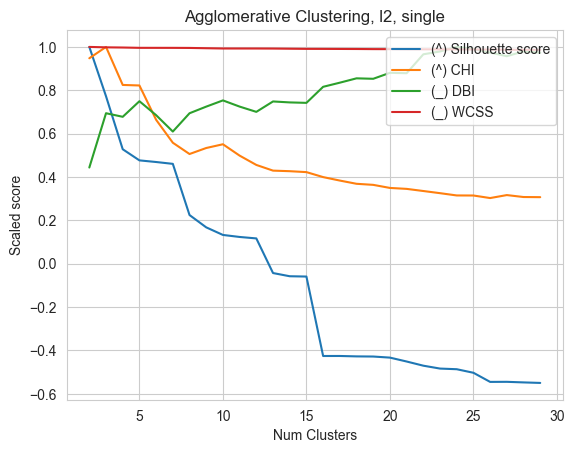

In [22]:
cl_metric = "l2"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "single"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

# Hierarchical Agglomerate Clustering, Cosine

100%|██████████| 28/28 [00:36<00:00,  1.31s/it]


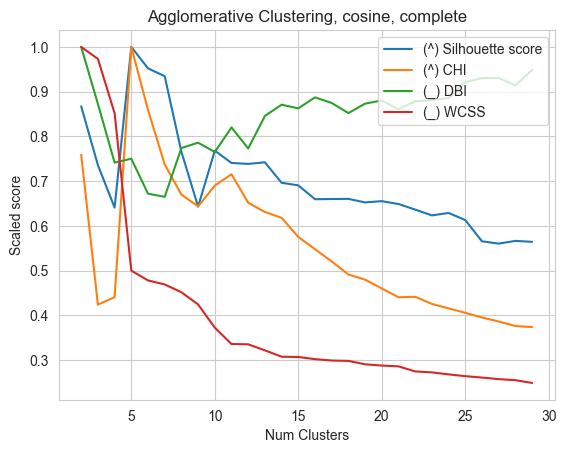

In [23]:
cl_metric = "cosine"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "complete"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:37<00:00,  1.32s/it]


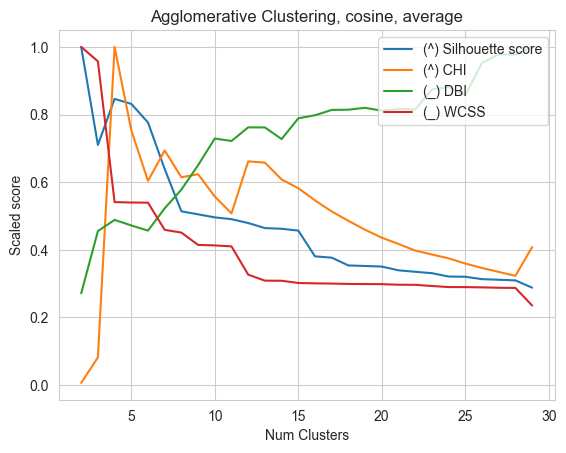

In [24]:
cl_metric = "cosine"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "average"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

100%|██████████| 28/28 [00:35<00:00,  1.28s/it]


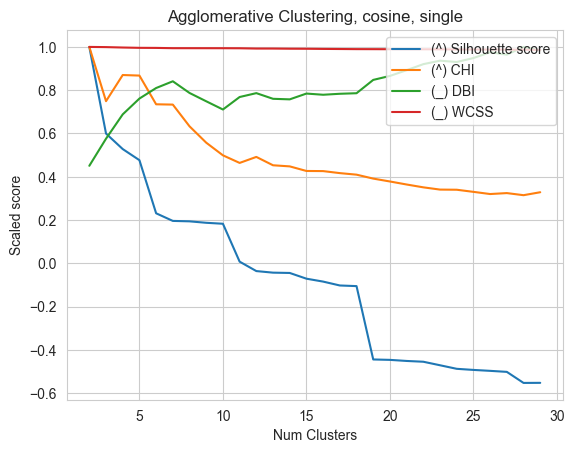

In [25]:
cl_metric = "cosine"
# linkage: "ward", "complete", "average", "single"
cl_linkage = "single"

agg_fits = []
agg_num_clusters = list(range(2, 30))

for cl_num in tqdm(agg_num_clusters):
    agg_model = AgglomerativeClustering(
        n_clusters=cl_num,
        metric=cl_metric,
        linkage=cl_linkage,
    ).fit(data_embed)
    agg_fits.append(agg_model)

silhouette_scores = [silhouette_score(data_embed, agg_model_.labels_)
                     if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
davies_bouldin_indexes = [davies_bouldin_score(data_embed, agg_model_.labels_)
                          if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
calinski_harabasz_indexes = [calinski_harabasz_score(data_embed, agg_model_.labels_)
                             if len(set(agg_model_.labels_)) > 1 else 0 for agg_model_ in tqdm(agg_fits)]
wcss_metrics = [wcss_metric(data_embed, agg_model_.labels_)
                for agg_model_ in tqdm(agg_fits)]

draw_metrics_many_norm(
    agg_num_clusters,
    {
        "(^) Silhouette score": silhouette_scores,
        "(^) CHI": calinski_harabasz_indexes,
        "(_) DBI": davies_bouldin_indexes,
        "(_) WCSS": wcss_metrics,
    },
    xlabel="Num Clusters",
    ylabel="Scaled score",
    title=f"Agglomerative Clustering, {cl_metric}, {cl_linkage}",
)

# Hierarchical Agglomerate Clustering, Euclidian

Silhouette Score (MORE): 0.20440199839799456
Davies-Bouldin Index (LESS): 1.2746231451148289
Calinski-Harabasz Index (MORE): 1716.4916738772051
WCSS (LESS): 13639.383816052688


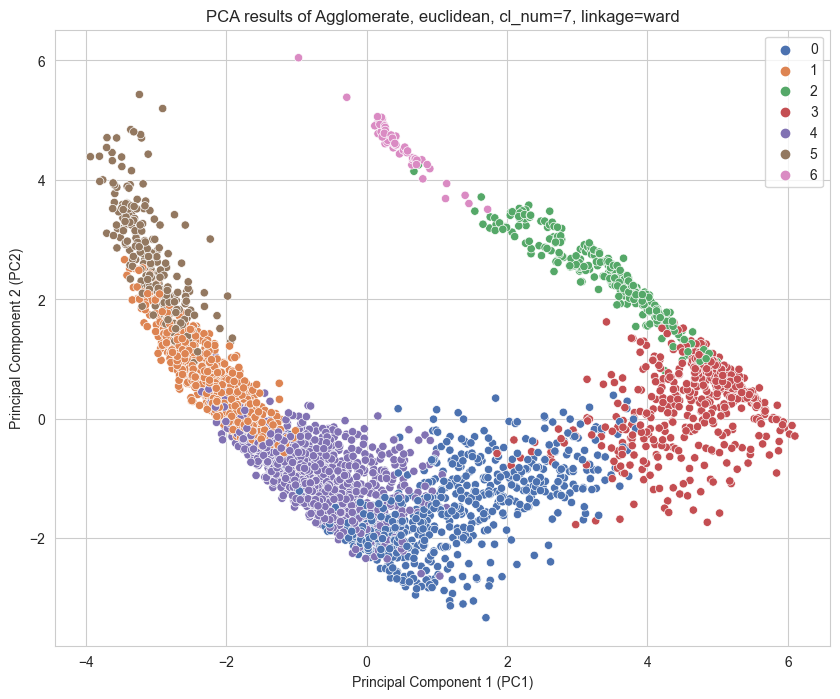

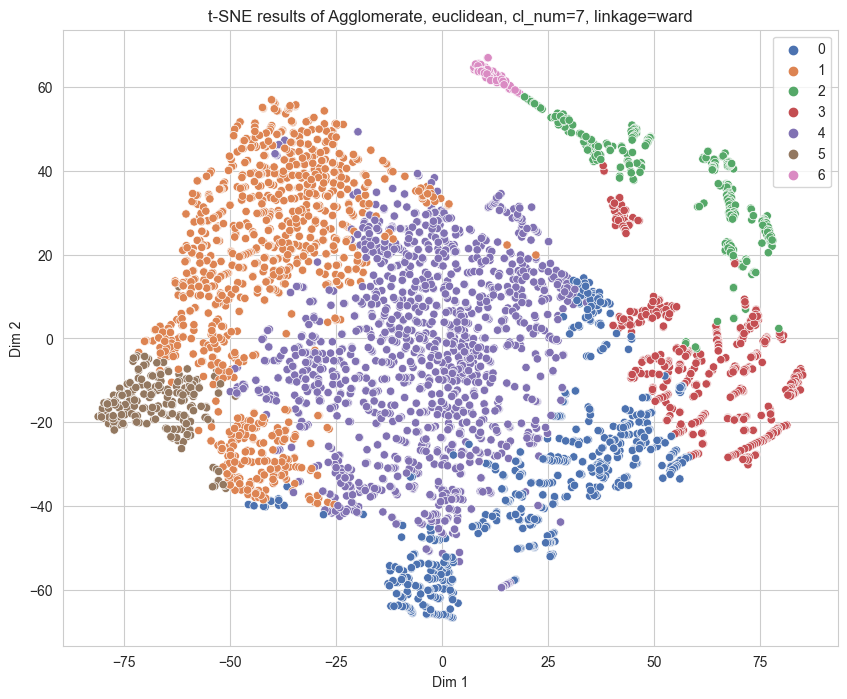

In [34]:
cl_num = 7
cl_metric = "euclidean"
cl_linkage = "ward"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model )

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.234490873373491
Davies-Bouldin Index (LESS): 1.23166181683499
Calinski-Harabasz Index (MORE): 1764.5683025076726
WCSS (LESS): 17544.587679648394


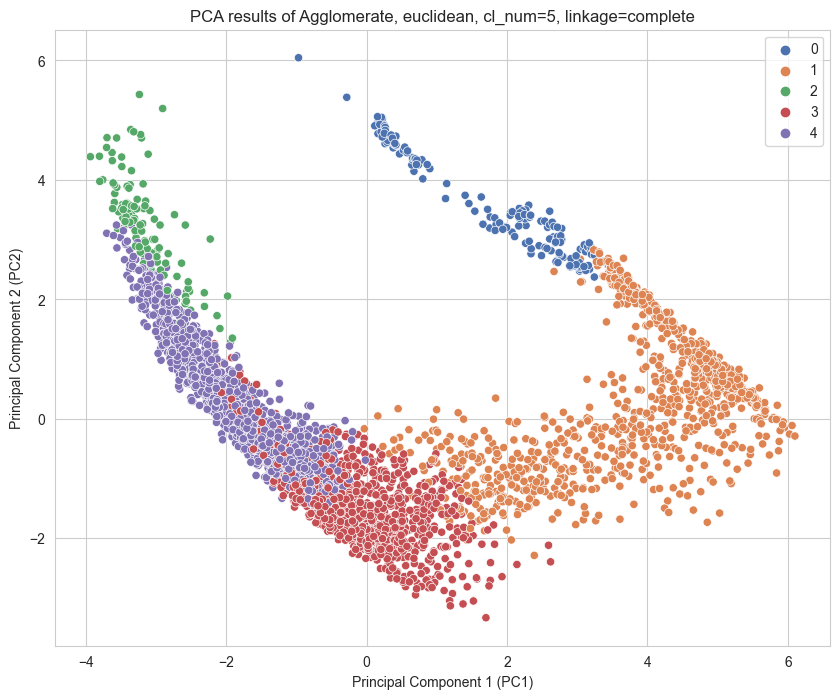

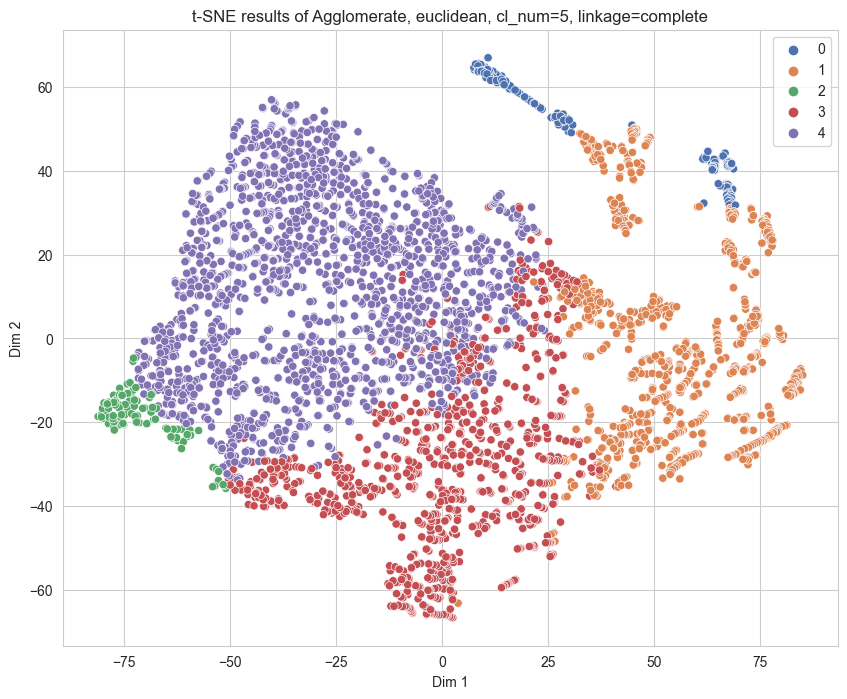

In [35]:
cl_num = 5
cl_metric = "euclidean"
cl_linkage = "complete"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model )

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.45919855850266983
Davies-Bouldin Index (LESS): 0.779354324802986
Calinski-Harabasz Index (MORE): 1818.4420005678144
WCSS (LESS): 25134.993265151075


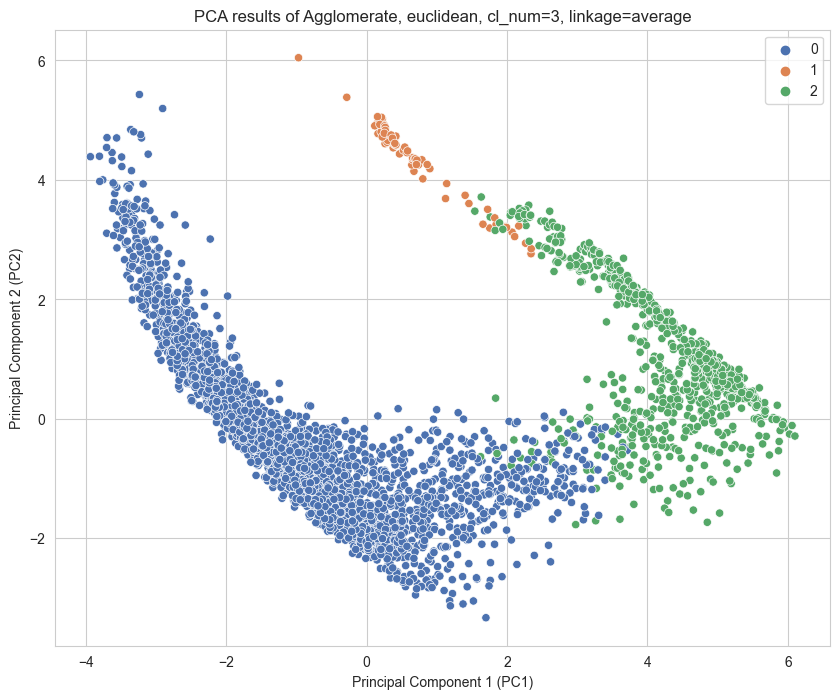

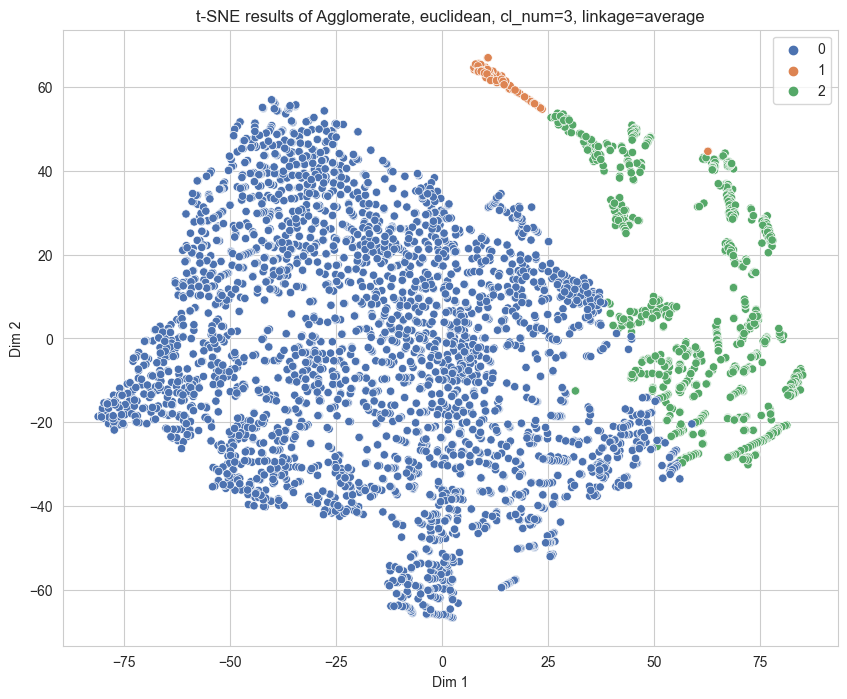

In [36]:
cl_num = 3
cl_metric = "euclidean"
cl_linkage = "average"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model )

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.24935760841646995
Davies-Bouldin Index (LESS): 0.4660556960903016
Calinski-Harabasz Index (MORE): 4.342941017344916
WCSS (LESS): 46216.46922963254


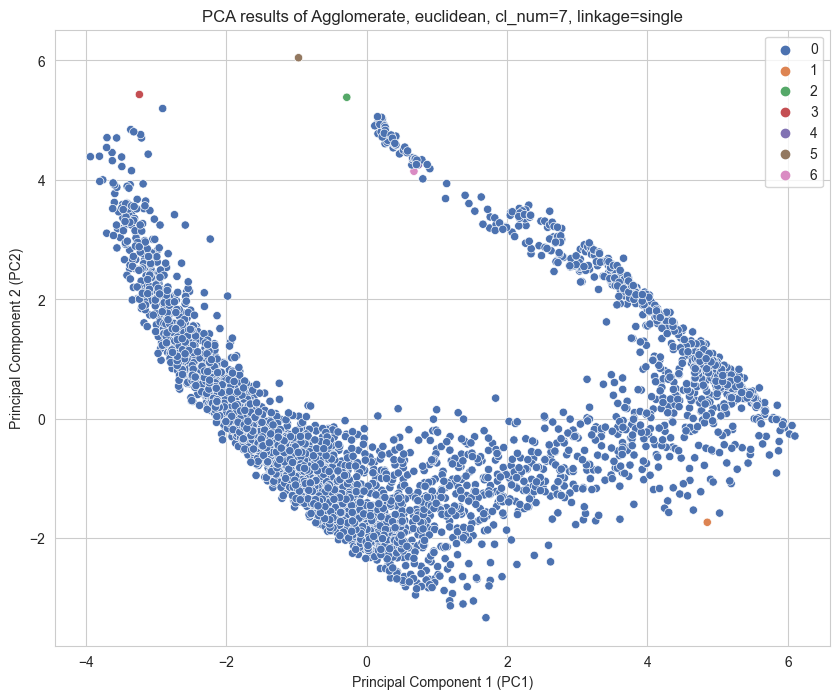

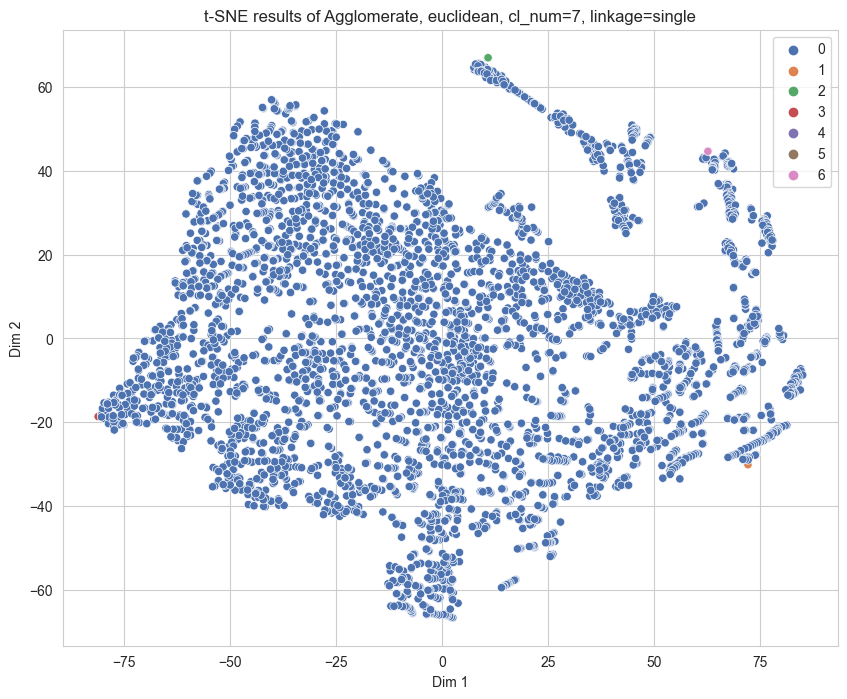

In [37]:
cl_num = 7
cl_metric = "euclidean"
cl_linkage = "single"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model )

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

# Hierarchical Agglomerate Clustering, L1

Silhouette Score (MORE): 0.15558633362264804
Davies-Bouldin Index (LESS): 1.8196260296468663
Calinski-Harabasz Index (MORE): 763.2378023332697
WCSS (LESS): 27131.516844604972


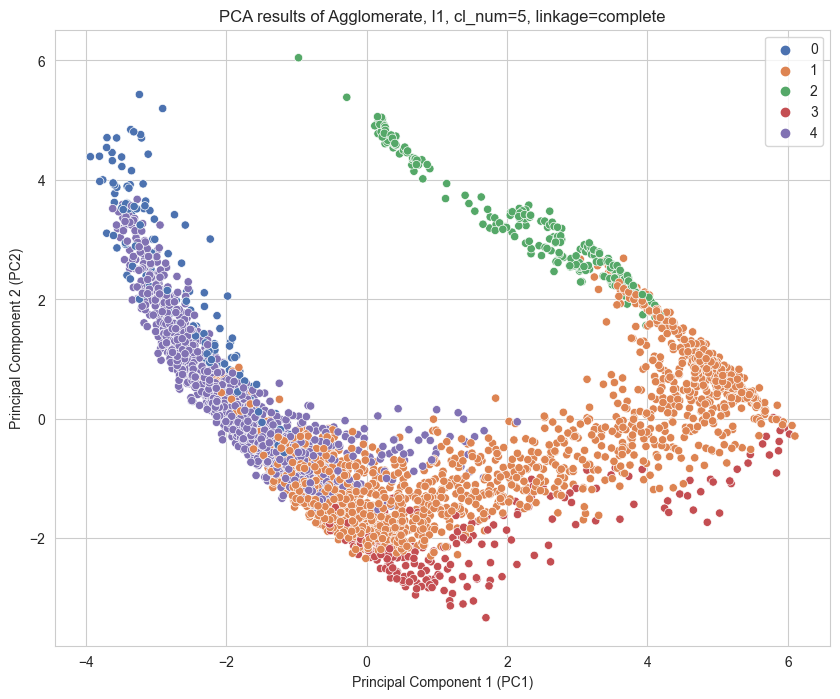

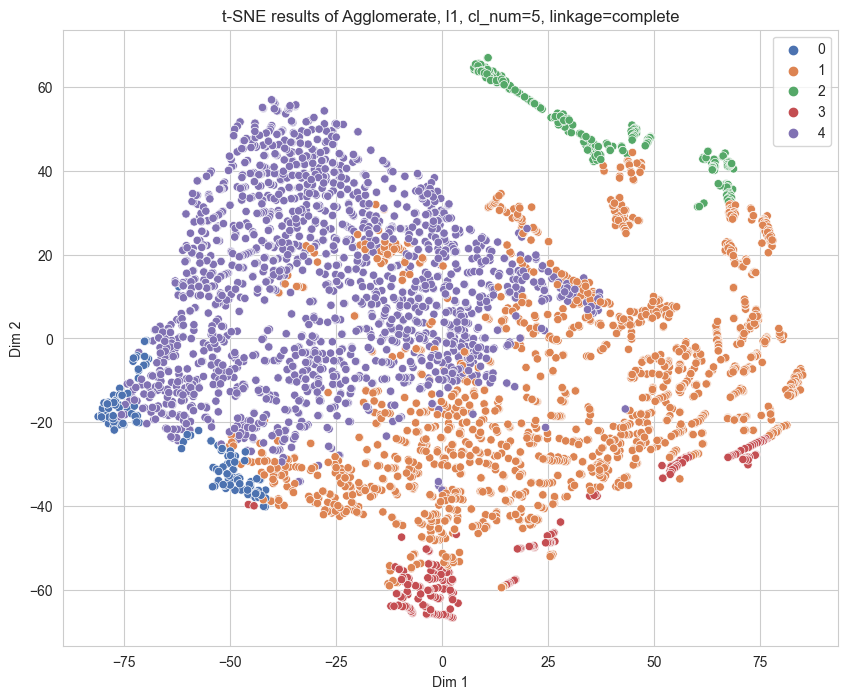

In [38]:
cl_num = 5
cl_metric = "l1"
cl_linkage = "complete"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.2728937255174865
Davies-Bouldin Index (LESS): 0.8685516810843131
Calinski-Harabasz Index (MORE): 591.2284589619303
WCSS (LESS): 22069.36634259929


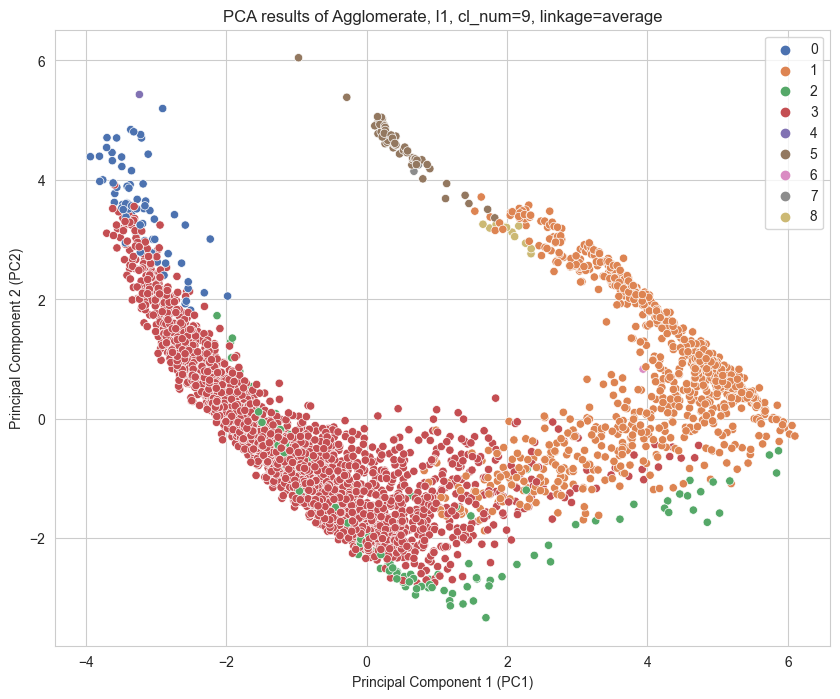

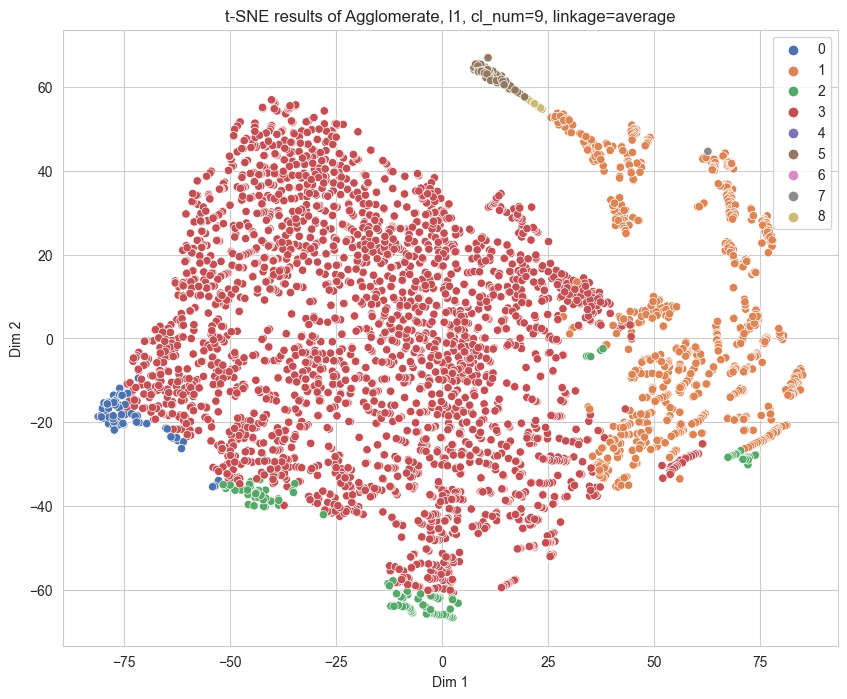

In [39]:
cl_num = 9
cl_metric = "l1"
cl_linkage = "average"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.4181823067794379
Davies-Bouldin Index (LESS): 0.5307121993436845
Calinski-Harabasz Index (MORE): 7.782835607494987
WCSS (LESS): 46329.6422243255


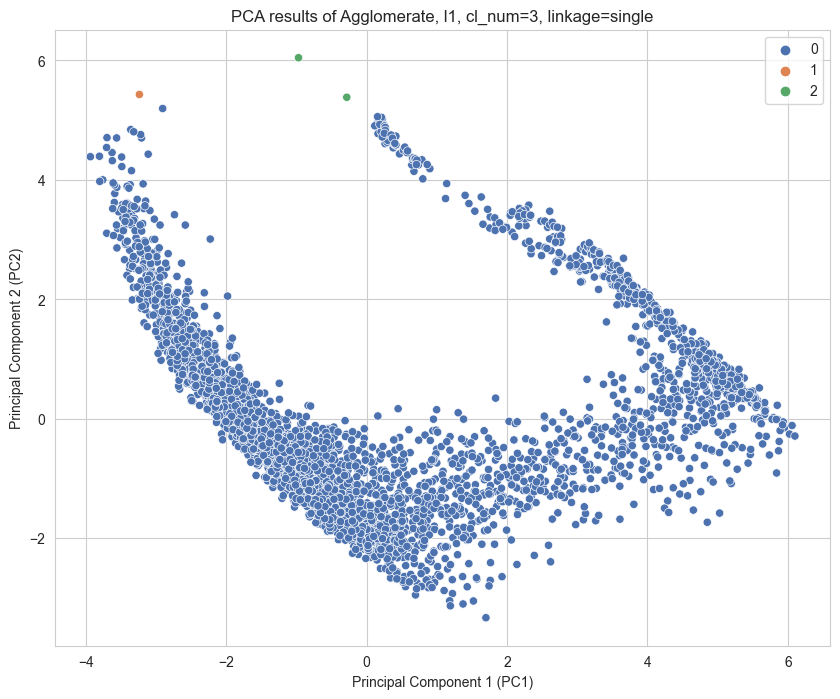

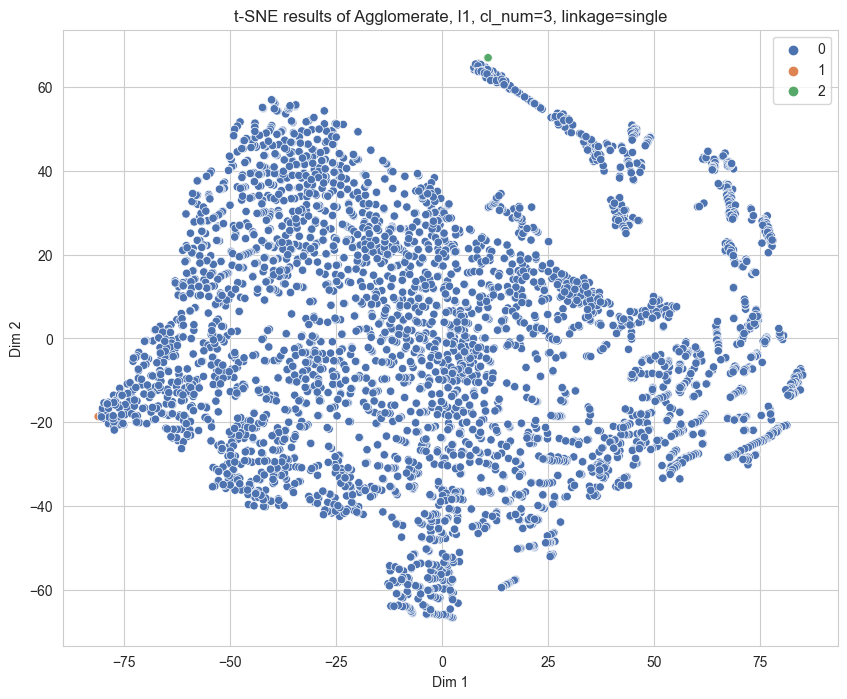

In [40]:
cl_num = 3
cl_metric = "l1"
cl_linkage = "single"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

# Hierarchical Agglomerate Clustering, L2

Silhouette Score (MORE): 0.234490873373491
Davies-Bouldin Index (LESS): 1.23166181683499
Calinski-Harabasz Index (MORE): 1764.5683025076726
WCSS (LESS): 17544.587679648394


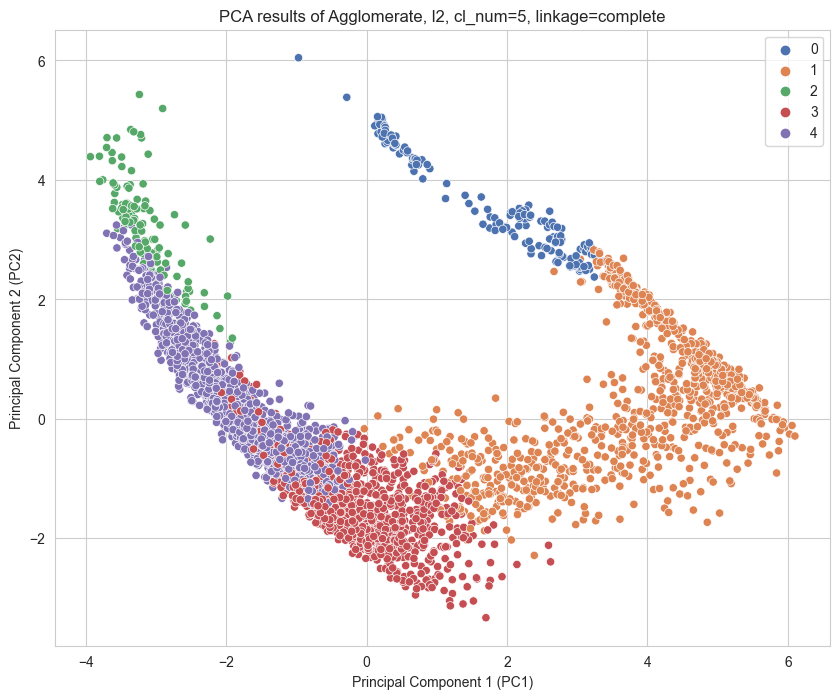

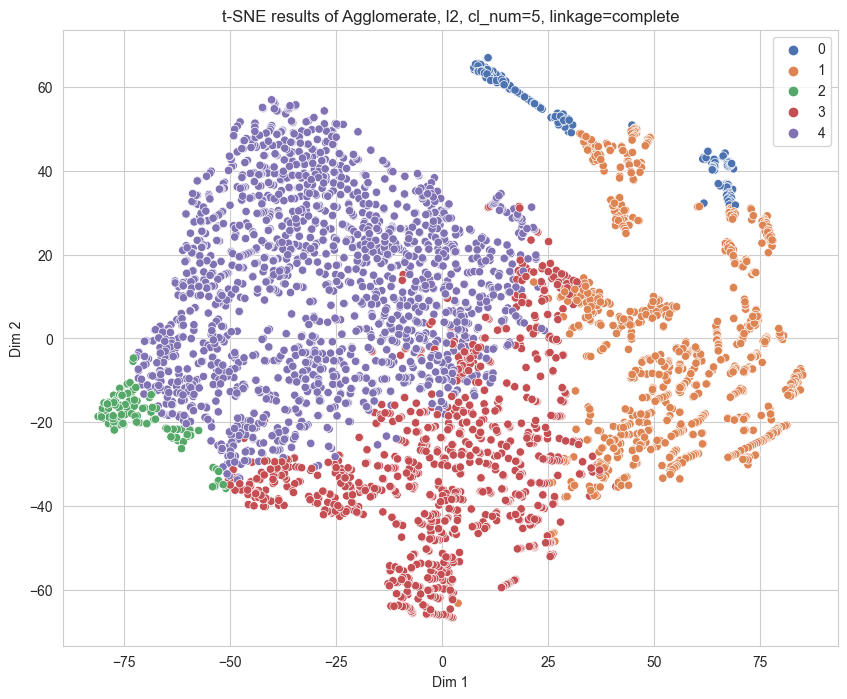

In [41]:
cl_num = 5
cl_metric = "l2"
cl_linkage = "complete"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.45919855850266983
Davies-Bouldin Index (LESS): 0.779354324802986
Calinski-Harabasz Index (MORE): 1818.4420005678144
WCSS (LESS): 25134.993265151075


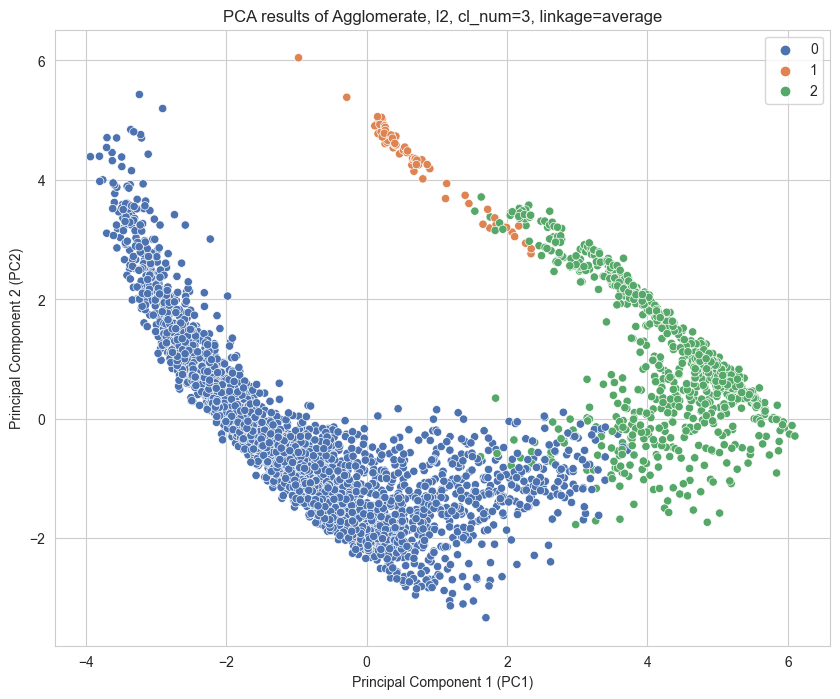

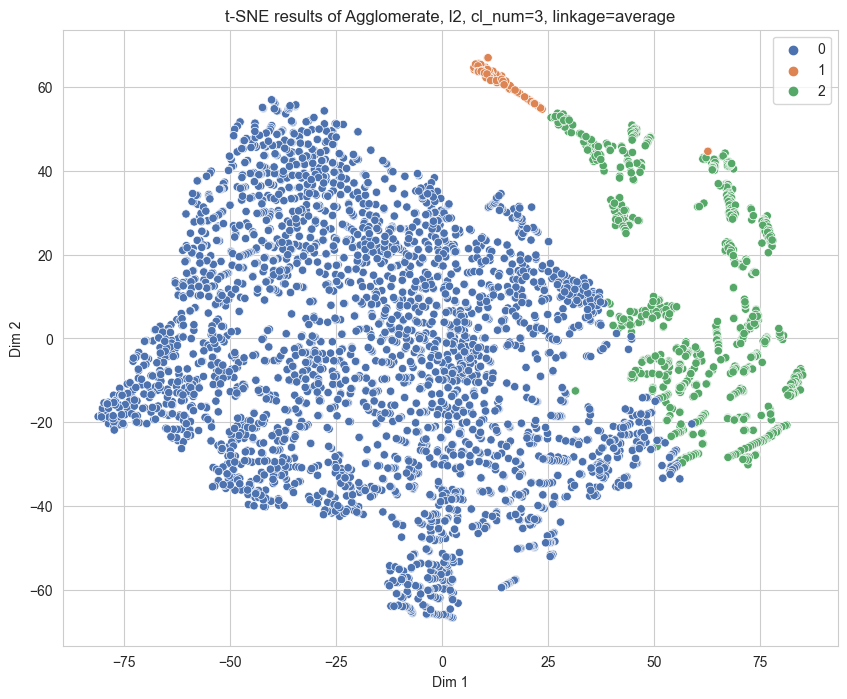

In [42]:
cl_num = 3
cl_metric = "l2"
cl_linkage = "average"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.4181823067794379
Davies-Bouldin Index (LESS): 0.5307121993436845
Calinski-Harabasz Index (MORE): 7.782835607494987
WCSS (LESS): 46329.6422243255


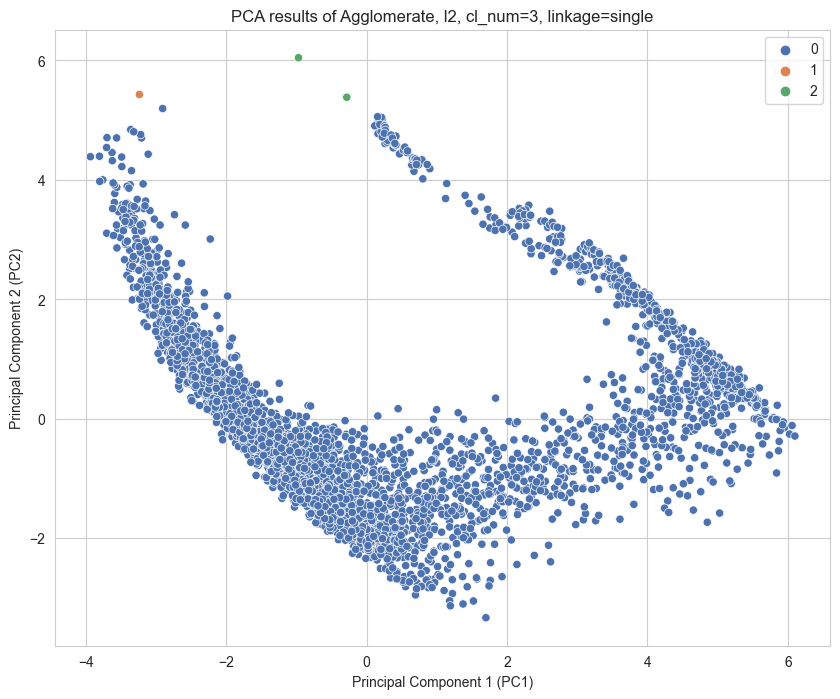

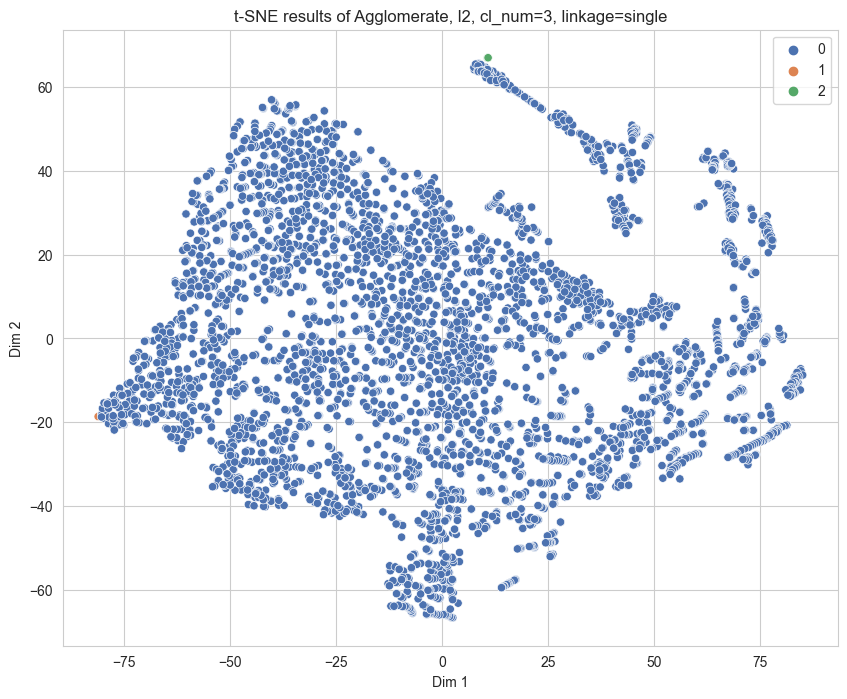

In [43]:
cl_num = 3
cl_metric = "l2"
cl_linkage = "single"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

# Hierarchical Agglomerate Clustering, Cosine

Silhouette Score (MORE): 0.22684583387845064
Davies-Bouldin Index (LESS): 1.076986319722727
Calinski-Harabasz Index (MORE): 1478.8927727530593
WCSS (LESS): 17036.70041329023


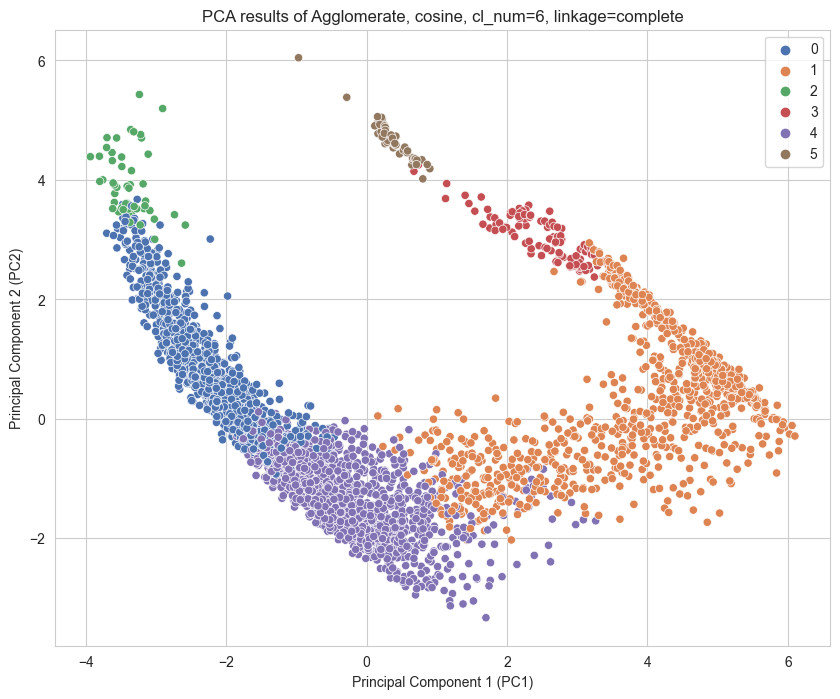

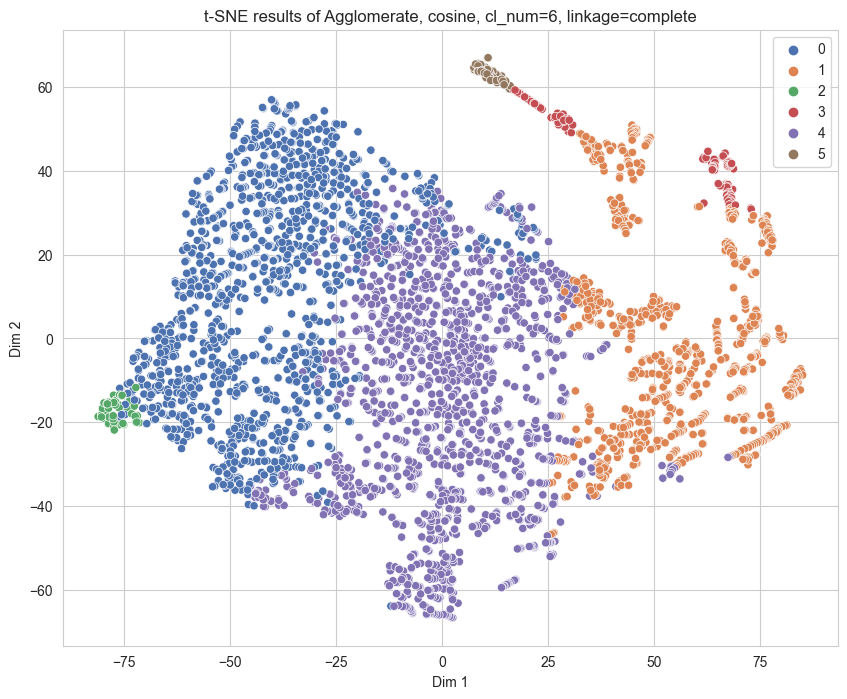

In [44]:
cl_num =6
cl_metric = "cosine"
cl_linkage = "complete"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.45827730744998363
Davies-Bouldin Index (LESS): 0.6108604612782217
Calinski-Harabasz Index (MORE): 1214.7342242912678
WCSS (LESS): 25109.076489840518


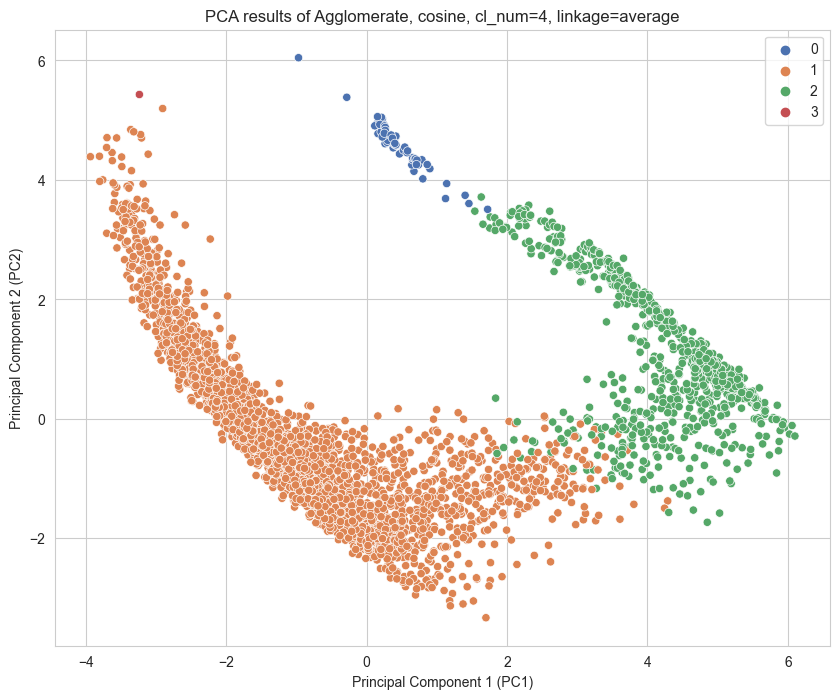

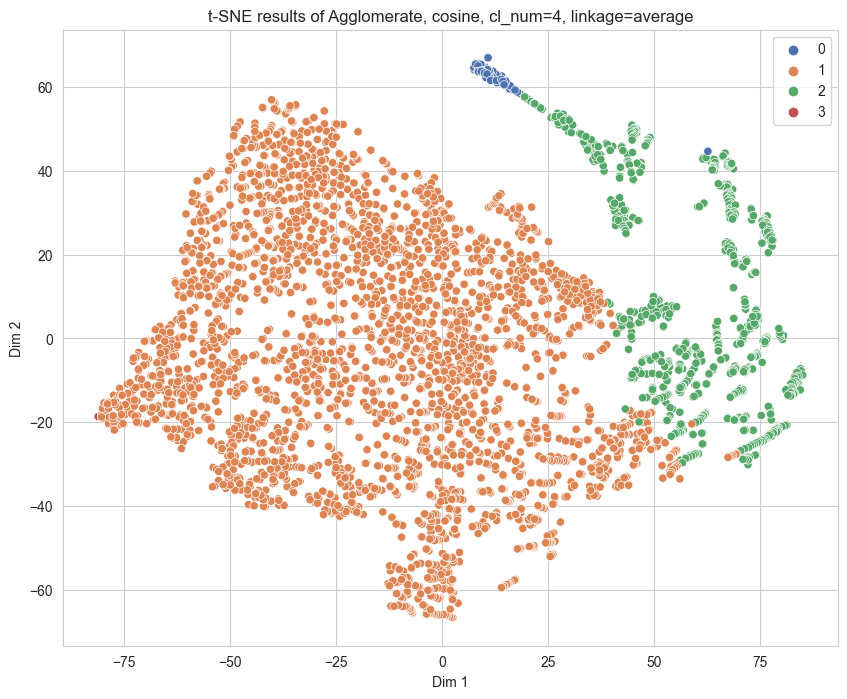

In [45]:
cl_num = 4
cl_metric = "cosine"
cl_linkage = "average"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")

Silhouette Score (MORE): 0.28586657663655024
Davies-Bouldin Index (LESS): 0.5180719538931713
Calinski-Harabasz Index (MORE): 6.417679872018253
WCSS (LESS): 46289.8486655046


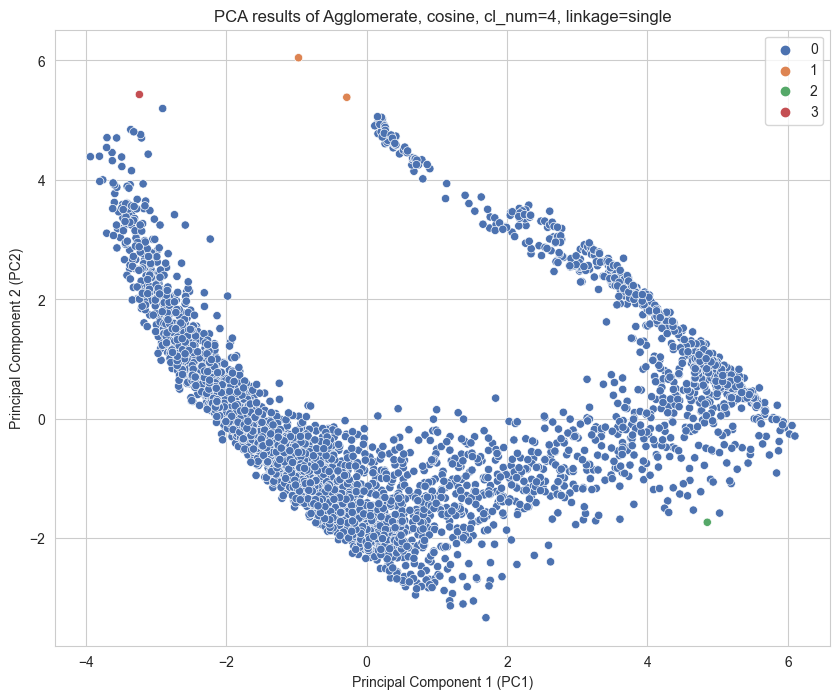

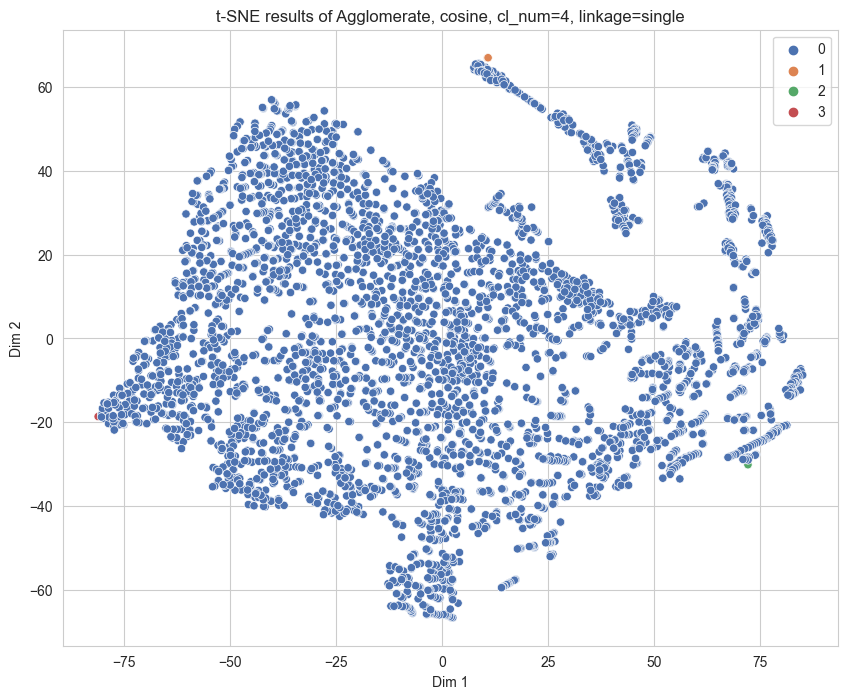

In [46]:
cl_num = 4
cl_metric = "cosine"
cl_linkage = "single"

agg_model = AgglomerativeClustering(
    n_clusters=cl_num,
    metric=cl_metric,
    linkage=cl_linkage,
).fit(data_embed)
agg_fits.append(agg_model)

show_clustering_metrics(data_embed, agg_model)

visualize_clusters(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")
# visualize_clusters_3d_pca(agg_model, f"Agglomerate, {cl_metric}, cl_num={cl_num}, linkage={cl_linkage}")